# <center> Майнор "Интеллектуальный анализ данных" </center>

# <center> Курс "Введение в анализ данных" </center>

# <center> Лабораторная работа №2. Кластерный анализ. </center>

# Часть 1

В данном задании вам необходимо **самостоятельно** реализовать один из алгоритмов кластеризации.  
По аналогии с классами в scikit-learn, нужно реализовать класс, наследуемый от [Base Estimator](https://scikit-learn.org/stable/modules/generated/sklearn.base.BaseEstimator.html).  
Подробнее про реализацию своих моделей в scikit-learn: [here](https://scikit-learn.org/stable/developers/develop.html#rolling-your-own-estimator).  
В классе помимо `__init__()` нужно реализовать два метода:
 - `fit()` - метод, выполняющий кластеризацию данных.
 - `predict()` - метод, определяющий для нового объекта, к какому из кластеров он относится. 
 
Для удобства можно создавать дополнительные методы класса, которые будут вызываться в `fit()` или `predict()`.  <br>
Функции для вычисления расстояний *между объектами* самим реализовывать не нужно, используйте реализации из `scipy`.

### Вариант №2

Алгоритм Dbscan.  
  
Параметры: 
- **eps:** радиус окрестности $\varepsilon$;  
- **min_samples:** минимальное число объектов в окрестности $\varepsilon$ для основных точек;  
- **metric:** функция расстояния между объектами. Должны поддерживаться метрики из `scipy.spatial.distance`, самописные функции (callable) и предрассчитанная матрица расстояний.   
- **metric_params:** параметры функции расстояния, если такие есть. 
  
Атрибуты:  
- **core\_sample\_coords\_:** - векторы основных точек;
- **labels_:** метки кластеров для каждого объекта.
  
Метод `predict()`:  Для нового объекта вычисляется число основных точек из каждого кластера, попавших в окрестность $\varepsilon$. Объект определяется в кластер с наибольшим числом таких точек.  
**Note:** Метод `predict()` не выполняется в случае, когда **metric** - это матрица расстояний. 

In [1]:
import operator
import time
from itertools import combinations, repeat
import pandas as pd
import numpy as np
from scipy.spatial.distance import pdist, squareform, cdist
from sklearn.base import BaseEstimator, ClusterMixin
from sklearn.datasets import load_iris


class MyDBSCAN(BaseEstimator, ClusterMixin):
    """
    MyDBSCAN is my realization of DBSCAN algorithm from sklearn.
    It will return a list of cluster labels. The label -1 means noise, and then
    the clusters are numbered starting from 1.
    """

    def __init__(self, eps=0.5,
                 min_samples=5,
                 metric='euclidean',
                 metric_params=None):
        '''
        Parameters
        ----------
        eps : float, default=0.5
           Neighborhood radius 𝜀;

        min_samples : int, default=5
            minimum number of objects in the neighborhood 𝜀 for the main points;

        metric : string, or callable, default='euclidean'
            a function of the distance between objects;

        metric_params : dict, default=None
            Additional keyword arguments for the metric function;
        '''
        self.eps = eps
        self.min_samples = min_samples
        self.metric = metric
        self.metric_params = metric_params if metric_params else {}
        ###
        self.core_sample_coords_ = list()
        self.labels_ = None
        self.core_sample_indices_ = list()
        ###
        self.X = None
        self.size = 0
        self.clusters = 0

    def get_neighbours(self, dist_matrix: list) -> list:
        """
        Find all neighbours of all points, if they exist.
        :param dist_matrix: Pairwise distances between observations
                            in n-dimensional space.
        :return: List of all neighbours.
        """
        all_combs = list(combinations(range(self.size), 2))
        all_neighbours = [[] * self.size for i in repeat(None, self.size)]
        for i in range(0, len(all_combs)):
            comb = list(all_combs[i])
            dist = dist_matrix[i]
            if dist <= self.eps:
                all_neighbours[comb[1]].append(comb[0])
                all_neighbours[comb[0]].append(comb[1])
        return all_neighbours

    def boost_cluster(self, point: int, point_neighbors: list, all_neighbours: list):
        """
        Make a new cluster with label self.cluster from a particular point .\

        :param point: The initial point for new cluster
        :param point_neighbors: Neighbors of this point
        :param all_neighbours: List of all neighbours for each point.
        """
        self.labels_[point] = self.clusters
        self.core_sample_coords_.append(self.X[point])
        self.core_sample_indices_.append(point)

        counter = 0
        while counter < len(point_neighbors):
            new_point = point_neighbors[counter]

            # if this neighbor doesn't have enough points in its eps
            # reachable point
            if self.labels_[new_point] == -1:
                self.labels_[new_point] = self.clusters

            elif self.labels_[new_point] == 0:
                self.labels_[new_point] = self.clusters

                self.core_sample_coords_.append(self.X[new_point])
                self.core_sample_indices_.append(point)

                # get neighbors including 'core' point
                nPoint_neighbors = [new_point] + all_neighbours[new_point]

                if len(nPoint_neighbors) >= self.min_samples:
                    point_neighbors.extend(nPoint_neighbors)

            counter += 1

    def define_status(self, all_neighbours: list):
        """
        Start to create clusters.
         There are two values:
           * -1 - noise point
           *  0 - initially all labels are 0.
        """
        self.labels_ = np.full(self.size, 0, dtype=np.int32)

        for point in range(0, self.size):

            if not (self.labels_[point] == 0):
                continue

            # get neighbors including 'core' point
            point_neighbors = [point] + all_neighbours[point]

            if len(point_neighbors) < self.min_samples:
                self.labels_[point] = -1
            else:
                self.clusters += 1
                self.boost_cluster(point, point_neighbors, all_neighbours)

        return self.labels_

    def fit(self, X):
        """
        Perform DBSCAN clustering from features, or distance matrix.

        :param X: {array-like, sparse matrix} of shape (n_samples, n_features), or \
            (n_samples, n_samples)
            Training instances to cluster, or distances between instances if
            ``metric='precomputed'``.
        """

        if self.eps < 0.0:
            raise ValueError("EPS must be positive!")

        self.X = X

        if self.metric != 'precomputed':
            dist_matrix = pdist(X=X, metric=self.metric, **self.metric_params)
        else:
            dist_matrix = squareform(X)
        self.size = X.shape[0]
        all_neighbours = self.get_neighbours(dist_matrix)

        return self.define_status(all_neighbours)

    def predict(self, X):
        '''
        For the new object, the number of main points
        from each cluster that fall in the neighborhood 𝜀 is calculated .
        The object is defined in the cluster
        with the largest number of such points.
        :param X:
        :return:
        '''
        if self.labels_ is None:
            raise ValueError('Data must be fitted use "predict()".')

        if self.metric == 'precomputed':
            raise ValueError('The "predict()" method is not executed when metric is a distance matrix.')

        n_samples = X.shape[0]
        new_labels = np.full(n_samples, 0, dtype=np.int32)
        dist_matrix = cdist(XA=X,
                            XB=self.core_sample_coords_,
                            metric=self.metric,
                            **self.metric_params)
        clusters = list(np.unique(self.labels_))

        for sample in range(0, n_samples):
            clust_to_size = {clust: 0 for clust in clusters}
            for point in range(0, len(self.core_sample_coords_)):
                if dist_matrix[0][point] <= self.eps:
                    clust = self.labels_[self.core_sample_indices_[point]]
                    clust_to_size[clust] += 1
            biggest_clust = max(clust_to_size.items(), key=operator.itemgetter(1))[0]
            new_labels[sample] = biggest_clust

        return new_labels

### Тестирование 

Вашу реализацию необходимо сравнить с питоновской реализацией алгоритма из `sklearn` или `scipy`. Результаты кластеризации должны совпадать.  
Также необходимо сравнить скорость работы вашей реализации и питоновской (это нормально, если ваша реализация будет медленнее).  
Сравнение необходимо выполнить на наборе данных iris.

In [2]:
import numpy as np
import pandas as pd
from sklearn.datasets import load_iris
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
iris = load_iris()
X = iris.data # использовать для кластеризации
y = iris.target # истинные метки цветков

#### Для создания нового объекта, который впоследствии будет использоваться в функции predict(), смотрю на данные в dataset "iris".

In [4]:
iris_df = pd.DataFrame(iris.data, columns=iris.feature_names)
iris_df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


#### Создаю новый объект

In [5]:
new_obj = {'sepal length(cm)': [5.1],
     'sepal width (cm)': [3.6],
     'petal length (cm)': [1.4],
     'petal width (cm)': [0.2]}

# NOISE EXAMPLE
# new_obj = {'sepal length(cm)': [100],
#      'sepal width (cm)': [100],
#      'petal length (cm)': [100],
#      'petal width (cm)': [100]}

df = pd.DataFrame(data=new_obj)
df

,sepal length(cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.6,1.4,0.2


#### Работа моей реализации алгоритма DBSCAN
* "MY TIME" -> показывает время работы моего алгоритма
* "MY LABELS" -> показывает разделение на кластеры
* "MY PREDICT" -> показывает кластер, в который был определен новый объект

In [223]:
# Work of my DBSCAN
start_time = time.time()
dbscan_clustering = MyDBSCAN()
dbscan_clustering.fit(X)
print('MY TIME: ', time.time() - start_time)
print('MY LABELS: ', dbscan_clustering.labels_)
print('MY PREDICT: ', dbscan_clustering.predict(df))

MY TIME:  0.005983829498291016
MY LABELS:  [ 1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1
  1  1  2  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2 -1  2  2
  2  2 -1  2  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]
MY PREDICT:  [1]


#### Работа алгоритма DBSCAN из библиотеки sklearn
* "ORIG TIME" -> показывает время работы алгоритма DBSCAN
* "ORIG LABELS" -> показывает разделение на кластеры

In [6]:
# COMPARISON
from sklearn.cluster import DBSCAN
start_time = time.time()
cl_dbscan = DBSCAN(eps=0.5, min_samples=5, metric='euclidean')
cl_dbscan.fit(X)
print("ORIG TIME: ", time.time() - start_time)
print('ORIG LABELS:', cl_dbscan.labels_)

ORIG TIME:  0.0019948482513427734
ORIG LABELS: [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  1  1  1  1  1 -1 -1  1 -1 -1  1  1  1  1  1  1  1 -1 -1  1
  1  1 -1  1  1  1  1  1  1  1  1 -1  1  1 -1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1]


### Вывод:
#### Из сравнения видно, что моя реализация алгоритма немного медленнее оригинала.

In [7]:
X = pd.DataFrame(X, columns=iris.feature_names)
X['class'] = [iris.target_names[i] for i in y]
X

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),class
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


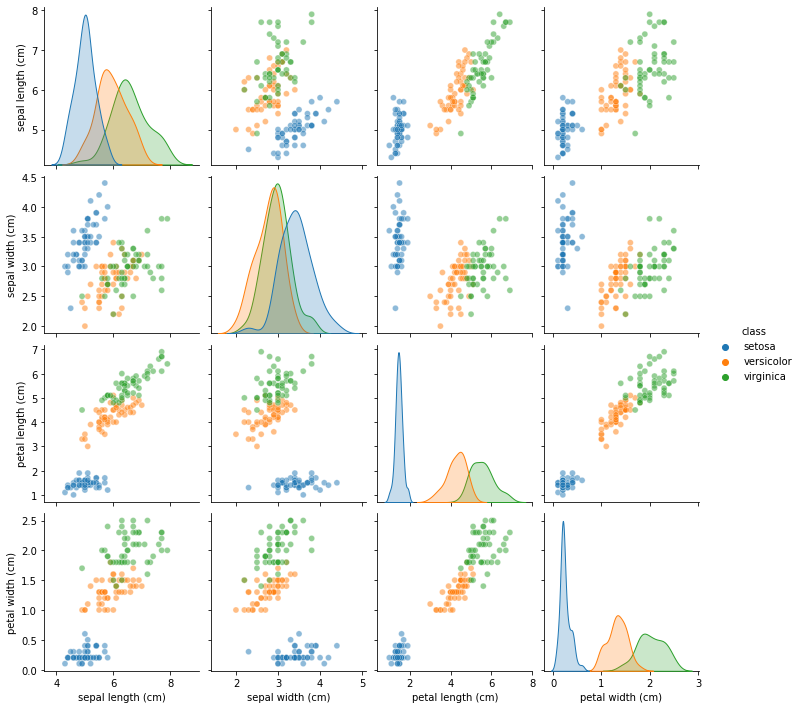

In [8]:
sns.pairplot(X, hue='class', plot_kws={'alpha':0.5}, vars=iris.feature_names)
plt.show()

### Visualisation 

In [9]:
setosa=X.loc[X["class"]=="setosa"]
versicolor=X.loc[X["class"]=="versicolor"]
virginica=X.loc[X["class"]=="virginica"]

In [10]:
import plotly.graph_objects as go
#adding figure for Length/Width visualization
fig1=go.Figure()
#adding traces
fig1.add_trace(go.Scatter(x=setosa['sepal width (cm)'], y=setosa['sepal length (cm)'], name='Setosa',
                        mode='markers', marker_color='rgb(52, 152, 219)',
                        marker_symbol='star-triangle-up', marker_opacity=0.8,
                        hovertemplate="<b>SepalWidthCm:</b> %{x} <br><b>SepalLengthCm:</b> %{y}"))

fig1.add_trace(go.Scatter(x=versicolor['sepal width (cm)'], y=versicolor['sepal length (cm)'], name='Versicolor',
                        mode='markers', marker_color='rgb(170, 128, 255)',
                        marker_symbol='hexagram', marker_opacity=0.8,
                        hovertemplate="<b>SepalWidthCm:</b> %{x} <br><b>SepalLengthCm:</b> %{y}"))

fig1.add_trace(go.Scatter(x=virginica['sepal width (cm)'], y=virginica['sepal length (cm)'], name='Virginica',
                        mode='markers', marker_color='rgb(241, 196, 15)',
                        marker_symbol='star-diamond', marker_opacity=0.8,
                        hovertemplate="<b>SepalWidthCm:</b> %{x} <br><b>SepalLengthCm:</b> %{y}"))
#customizing figure
fig1.update_traces(mode='markers', marker_line_width=1.5, marker_size=12)
fig1.update_layout(template='plotly_white', xaxis=dict(title_text='SepalWidthCm', title_standoff=10),
                   yaxis=dict(title_text='SepalLengthCm', title_standoff=10),
                   title_text='Sepal Length/Width', title_x=0.5)
fig1.update_xaxes(showline=True, linewidth=3, linecolor='black',
                  showspikes=True, spikecolor='red', spikethickness=2)
fig1.update_yaxes(showline=True, linewidth=3, linecolor='black',
                  showspikes=True, spikecolor='red', spikethickness=2)
#showing figure
fig1.show()

### Бонусное  
  
Дополнительно вы можете поработать над эффективностью алгоритма по скорости и памяти, добавить поддержку многопоточности, или расширить базовый функционал.

### Распределение по вариантам

In [207]:
pd.set_option('display.max_rows', 50)

In [208]:
Vars = pd.read_csv('Vars.txt', sep='\t')

#### Вариант №2

In [209]:
Vars[Vars.iloc[:,2] == 2]

,ФИО,Группа,Вариант №
1,Балаян Роман Каренович,1 ИАД,2
5,Даняев Артем Андреевич,1 ИАД,2
7,Ешманов Павел Андреевич,1 ИАД,2
10,Костин Андрей Олегович,1 ИАД,2
15,Ожиганова Полина Максимовна,1 ИАД,2
17,Сапожников Андрей Михайлович,1 ИАД,2
18,Семаев Никита Юрьевич,1 ИАД,2
21,Суворов Артём Андреевич,1 ИАД,2
25,Южаков Максим Вячеславович,1 ИАД,2
28,Бабий Александр Сергеевич,2 ИАД,2


# Часть 2

В данном задании вам предлагается проанализировать набор данных по различным городам США. Каждый город характеризуется следующими признаками:

In [210]:
pd.set_option('display.max_colwidth', None)

In [211]:
data_desc = pd.read_csv('Data_Description.txt', sep=':')
data_desc

,Attribute,Description
0,Place,"City, state (postal code)"
1,Climate & Terrain,"Very hot and very cold months, seasonal temperature variation, heating- and cooling-degree days, freezing days, zero-degree days, ninety-degree days."
2,Housing,"Utility bills, property taxes, mortgage payments."
3,Health Care & Environment,"Per capita physicians, teaching hospitals, medical schools, cardiac rehabilitation centers, comprehensive cancer treatment centers, hospices, insurance/hospitalization costs index, flouridation of drinking water, air pollution."
4,Crime,"Violent crime rate, property crime rate."
5,Transportation,"Daily commute, public transportation, Interstate highways, air service, passenger rail service."
6,Education,"Pupil/teacher ratio in the public K-12 system, effort index in K-12, accademic options in higher education."
7,The Arts,"Museums, fine arts and public radio stations, public television stations, universities offering a degree or degrees in the arts, symphony orchestras, theatres, opera companies, dance companies, public libraries."
8,Recreation,"Good restaurants, public golf courses, certified lanes for tenpin bowling, movie theatres, zoos, aquariums, family theme parks, sanctioned automobile race tracks, pari-mutuel betting attractions, major- and minor- league professional sports teams, NCAA Division I football and basketball teams, miles of ocean or Great Lakes coastline, inland water, national forests, national parks, or national wildlife refuges, Consolidated Metropolitan Statistical Area access."
9,Economics,"Average household income adjusted for taxes and living costs, income growth, job growth."


### Notes:   
* Для всех признаков, кроме трех, чем выше значение - тем лучше. Для признаков `Housing` и `Crime` - наоборот.
* Признак `Population`- статистический признак, не имеющий интерпретации как “лучше-хуже”.
* Признак `Place` - уникальный идентификатор объекта (города), он не должен использоваться при кластеризации.
* Также в данных присутствуют географические координаты городов - `Longitude` и `Latitude`. Их также не следует использовать при кластеризации данных.

In [326]:
data = pd.read_csv('Data.txt', sep=' ')
data

,Place,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Long,Lat,Pop
0,"Abilene,TX",521,6200,237,923,4031,2757,996,1405,7633,-99.6890,32.5590,110932
1,"Akron,OH",575,8138,1656,886,4883,2438,5564,2632,4350,-81.5180,41.0850,660328
2,"Albany,GA",468,7339,618,970,2531,2560,237,859,5250,-84.1580,31.5750,112402
3,"Albany-Schenectady-Troy,NY",476,7908,1431,610,6883,3399,4655,1617,5864,-73.7983,42.7327,835880
4,"Albuquerque,NM",659,8393,1853,1483,6558,3026,4496,2612,5727,-106.6500,35.0830,419700
...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,"Worcester,MA",562,8715,1805,680,3643,3299,1784,910,5040,-71.7950,42.2720,402918
325,"Yakima,WA",535,6440,317,1106,3731,2491,996,2140,4986,-120.5130,46.5950,172508
326,"York,PA",540,8371,713,440,2267,2903,1022,842,4946,-76.7280,39.9600,381255
327,"Youngstown-Warren,OH",570,7021,1097,938,3374,2920,2797,1327,3894,-80.7290,41.1700,531350


<br>  
  
## Задания: 

1. Выполните необходимую предобработку данных. Перед кластеризацией исключите из данных признаки `Place`, `Long` и `Lat`.  
  
  
2. Выполните кластеризацию иерархическим методом.  
Рассмотрите различные расстояния между объектами. Определите, какие следует использовать при кластеризации.  
Выполните кластеризацию с различными расстояниями между кластерами. Сравните результаты, сделайте выводы. 
  
  
3. Выполните кластеризацию методом Dbscan. Используйте расстояния между объектами, определенные в предыдущем пункте.  
Реализуйте эвристику (см. лекции) для выбора параметров алгоритма. Подберите подходящие параметры алгоритма.  
  
  
4. Выполните кластеризацию методом kmeans. Определите наилучшее (на ваш взгляд) число кластеров.  
  
  
5. (Бонусное) Выполните кластеризацию другими методами. Например, [HDBSCAN](https://hdbscan.readthedocs.io/en/latest/) или алгоритмы, [реализованные](https://scikit-learn.org/stable/modules/clustering.html) в scikit-learn.  
  
  
6. В результате выполнения предыдущих пунктов вы должны получить 4 или больше разбиений объектов (по одному на каждый метод). Сравните их между собой, сделайте выводы о сходствах и различиях.  
Оцените результаты каждой кластеризации, используя метрики, рассмотренные на занятиях (Silhouette и прочие).  
  
  
7. Выберите одно разбиение, наиболее подходящее на ваш взгляд. Предложите интерпретацию полученным кластерам или покажите, что этого сделать нельзя.  
  
  
8. Оцените, как полученные кластеры распределены географически.  
Оцените, как полученные кластеры распределены по штатам. Можно ли выделить какую-то зависимость (территориальную или для штатов)?  
(Бонусное) [Провизуализируйте](https://python-visualization.github.io/folium/quickstart.html) распределение на карте США.

# 1.  Переработка данных

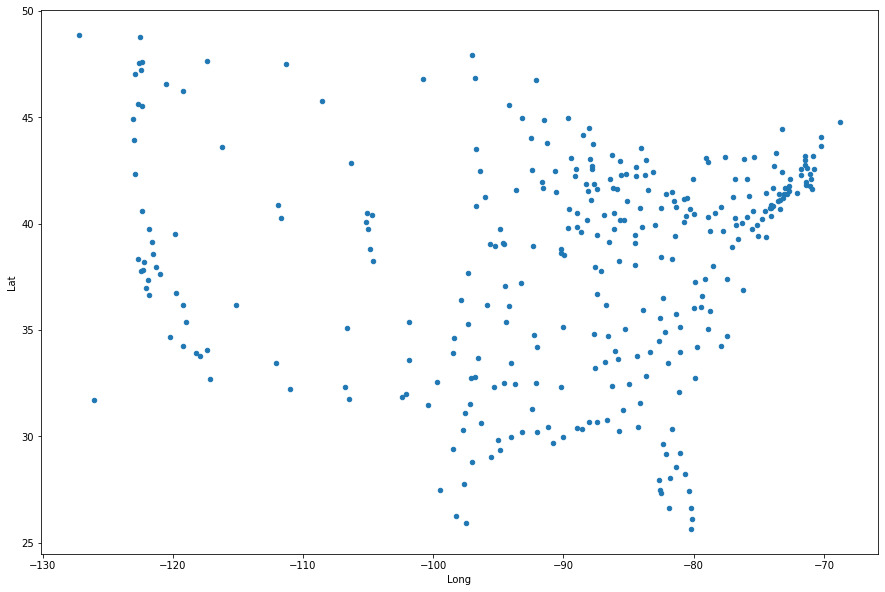

In [327]:
cmap = sns.cubehelix_palette(as_cmap=True)

data.plot.scatter(x="Long", 
                 y="Lat", 
                 figsize=(15, 10), 
                 cmap=cmap)
plt.show()

* Какой то общирной информации визуализация не дала. Тем не менее, можно высказать предположения о возможной кластеризации. На карте явно виднеются контуры. ТаНапример, хотелось бы видеть отдельными кластерами скопления в пракой верхней части графика. Так как если вспоминать карту расположения штатов США, то можно сказать, что именно в том месте расположены круные городские центры.

In [328]:
# Выполните необходимую предобработку данных. Перед кластеризацией исключите из данных признаки Place, Long и Lat.
data_copy = data.copy(deep=True)
data_copy.drop(['Place', 'Long', 'Lat'], axis=1, inplace=True)
data_copy

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop
0,521,6200,237,923,4031,2757,996,1405,7633,110932
1,575,8138,1656,886,4883,2438,5564,2632,4350,660328
2,468,7339,618,970,2531,2560,237,859,5250,112402
3,476,7908,1431,610,6883,3399,4655,1617,5864,835880
4,659,8393,1853,1483,6558,3026,4496,2612,5727,419700
...,...,...,...,...,...,...,...,...,...,...
324,562,8715,1805,680,3643,3299,1784,910,5040,402918
325,535,6440,317,1106,3731,2491,996,2140,4986,172508
326,540,8371,713,440,2267,2903,1022,842,4946,381255
327,570,7021,1097,938,3374,2920,2797,1327,3894,531350


In [329]:
data_copy.shape

(329, 10)

* Проверяю данные на отсутствие значений.

In [330]:
data_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 329 entries, 0 to 328
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   Climate      329 non-null    int64
 1   HousingCost  329 non-null    int64
 2   HlthCare     329 non-null    int64
 3   Crime        329 non-null    int64
 4   Transp       329 non-null    int64
 5   Educ         329 non-null    int64
 6   Arts         329 non-null    int64
 7   Recreat      329 non-null    int64
 8   Econ         329 non-null    int64
 9   Pop          329 non-null    int64
dtypes: int64(10)
memory usage: 25.8 KB


In [331]:
missing_vals = data_copy.isna()
print('Missing values by features:', missing_vals.sum(), sep='\n')

Missing values by features:
Climate        0
HousingCost    0
HlthCare       0
Crime          0
Transp         0
Educ           0
Arts           0
Recreat        0
Econ           0
Pop            0
dtype: int64


* Очевидно, что пропущенные значения отсутствуют.

In [434]:
for column in  data_copy.columns:
    print(f"{column}: unique data --> {data_copy[column].unique()}")

Climate: unique data --> [521 575 468 476 659 520 559 537 561 609 885 195 530 591 546 560 396 694
 601 696 615 534 474 435 567 451 427 527 423 586 772 566 452 584 550 612
 149 558 487 592 623 459 440 808 648 516 383 571 637 401 434 525 569 627
 644 618 576 514 603 544 579 526 541 517 362 545 480 444 536 336 419 193
 257 467 461 605 741 643 148 549 507 540 552 490 572 342 602 482 509 528
 402 727 483 105 513 410 367 626 655 568 542 556 717 424 636 600 557 518
 412 457 564 466 663 547 479 580 496 365 670 512 352 494 429 469 307 548
 635 522 398 497 500 616 604 642 447 378 404 238 611 582 634 593 460 293
 442 639 455 538 656 583 498 638 554 632 910 333 726 524 890 617 491 630
 463 768 488 647 614 664 535 585 652 308 515 475 716 843 903 850 855 732
 391 570 508 385 276 574 453 625 501 589 470 821 543 631 347 456 597 562
 608]
HousingCost: unique data --> [ 6200  8138  7339  7908  8393  5819  8288  6487  6191  6546 16047 12175
  5704  5725 11014  5530  7877  6722  6691  8316 11074  6292 103

* Здесь хотела убедиться, что нет знаков по типу "?" или каких либо других изменений в данных.
* Все вышеперечисленное отсутствует. 

### Стандартизация и нормализация данных

In [333]:
data_copy.describe()

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop
count,329.000000,329.000000,329.000000,329.000000,329.000000,329.000000,329.000000,329.000000,329.000000,3.290000e+02
mean,538.732523,8346.559271,1185.738602,961.054711,4210.082067,2814.887538,3150.884498,1845.957447,5525.364742,5.221184e+05
std,120.808259,2385.262622,1003.002036,357.154186,1451.179240,320.792953,4642.283738,807.888171,1084.468523,8.933226e+05
min,105.000000,5159.000000,43.000000,308.000000,1145.000000,1701.000000,52.000000,300.000000,3045.000000,6.282000e+04
25%,480.000000,6760.000000,583.000000,707.000000,3141.000000,2619.000000,778.000000,1316.000000,4842.000000,1.328660e+05
50%,542.000000,7877.000000,833.000000,947.000000,4080.000000,2794.000000,1871.000000,1670.000000,5384.000000,2.416170e+05
75%,592.000000,9015.000000,1445.000000,1156.000000,5205.000000,3012.000000,3844.000000,2176.000000,6113.000000,5.152590e+05
max,910.000000,23640.000000,7850.000000,2498.000000,8625.000000,3781.000000,56745.000000,4800.000000,9980.000000,8.274961e+06


* Так как производится работа с расстояниями между объектами, разнородность в величинах признаков может сильно исказить результаты анализа. Так, признак, который сам по себе принимает высокие значений может быть определяющим при вычислении расстояний, в то время как признаки с низкими значениями могут не оказывать почти никакого влияния.

* Чтобы решить эту проблему, перед анализом я выполняю СТАНДАРТИЗАЦИЮ данных.


In [334]:
from sklearn import preprocessing

In [335]:
# приведение в диапазон от 0 до 1
min_max_scaler = preprocessing.MinMaxScaler()
 
data_minmax = min_max_scaler.fit_transform(data_copy)
data_minmax = pd.DataFrame(data_minmax, columns=data_copy.columns)

data_minmax.head(10)

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop
0,0.516770,0.056328,0.024849,0.280822,0.385829,0.507692,0.016651,0.245556,0.661572,0.005859
1,0.583851,0.161193,0.206609,0.263927,0.499733,0.354327,0.097225,0.518222,0.188176,0.072759
2,0.450932,0.117959,0.073652,0.302283,0.185294,0.412981,0.003263,0.124222,0.317952,0.006038
3,0.460870,0.148747,0.177789,0.137900,0.767112,0.816346,0.081192,0.292667,0.406489,0.094136
4,0.688199,0.174991,0.231843,0.536530,0.723663,0.637019,0.078387,0.513778,0.386734,0.043458
5,0.515528,0.035712,0.076470,0.191324,0.173663,0.611058,0.004974,0.159556,0.318529,0.008824
6,0.563975,0.169309,0.074036,0.094064,0.232086,0.693750,0.040234,0.181556,0.295890,0.069733
7,0.536646,0.071858,0.118099,0.181735,0.512032,0.598077,0.025312,0.217778,0.396539,0.025013
8,0.566460,0.055841,0.049827,0.041553,0.414572,0.517788,0.003598,0.202222,0.170872,0.008987
9,0.626087,0.075050,0.080184,0.349315,0.502273,0.553365,0.020867,0.179778,0.460851,0.013502


# 

# 2. Иерархическая кластеризация

In [336]:
# Выполните кластеризацию иерархическим методом.
# Рассмотрите различные расстояния между объектами. Определите, какие следует использовать при кластеризации.
# Выполните кластеризацию с различными расстояниями между кластерами. Сравните результаты, сделайте выводы.

In [337]:
d = {'euclidean': pdist(data_minmax, 'euclidean'),
     'cityblock': pdist(data_minmax, 'cityblock'),
     'minkowski_6': pdist(data_minmax, 'minkowski', p=6),
     'cosine': pdist(data_minmax, 'cosine'),
     'chebyshev': pdist(data_minmax, 'chebyshev'),
     'canberra': pdist(data_minmax, 'canberra')}

D = pd.DataFrame(d)
D.shape

(53956, 6)

* Считаю корреляции для точной оценки расстояний между объектами.

In [338]:
D_corr = D.corr().loc[['cityblock', 'euclidean', 'minkowski_6', 'chebyshev', 'canberra', 'cosine'],
                      ['cityblock', 'euclidean', 'minkowski_6', 'chebyshev', 'canberra', 'cosine']
                     ]
D_corr

,cityblock,euclidean,minkowski_6,chebyshev,canberra,cosine
cityblock,1.000000,0.970572,0.849873,0.794055,0.700462,0.609781
euclidean,0.970572,1.000000,0.944882,0.901756,0.667409,0.702166
minkowski_6,0.849873,0.944882,1.000000,0.990864,0.584902,0.736337
chebyshev,0.794055,0.901756,0.990864,1.000000,0.553503,0.721248
canberra,0.700462,0.667409,0.584902,0.553503,1.000000,0.611510
cosine,0.609781,0.702166,0.736337,0.721248,0.611510,1.000000


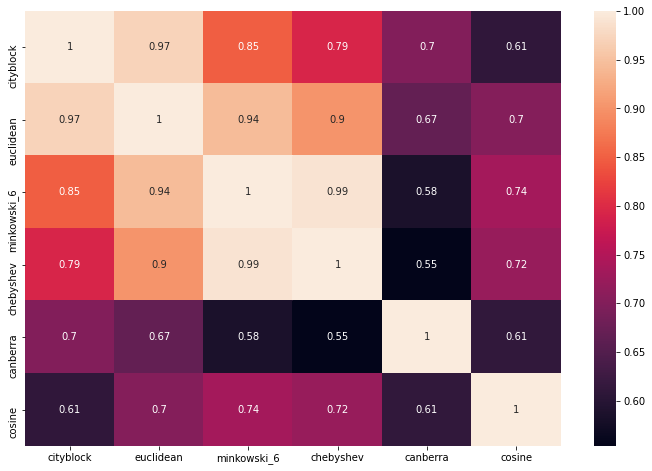

In [339]:
plt.figure(figsize=(12, 8))
sns.heatmap(D_corr, annot=True)
plt.show()

* Kосинусное расстояние и canberra сильно отличаются от остальных, они не будут учавствовать в кластеризации, остальные расстояния в данных оказались более похожими. 

* Строю pairplot, чтобы попытаться оценить, как распределены объекты.

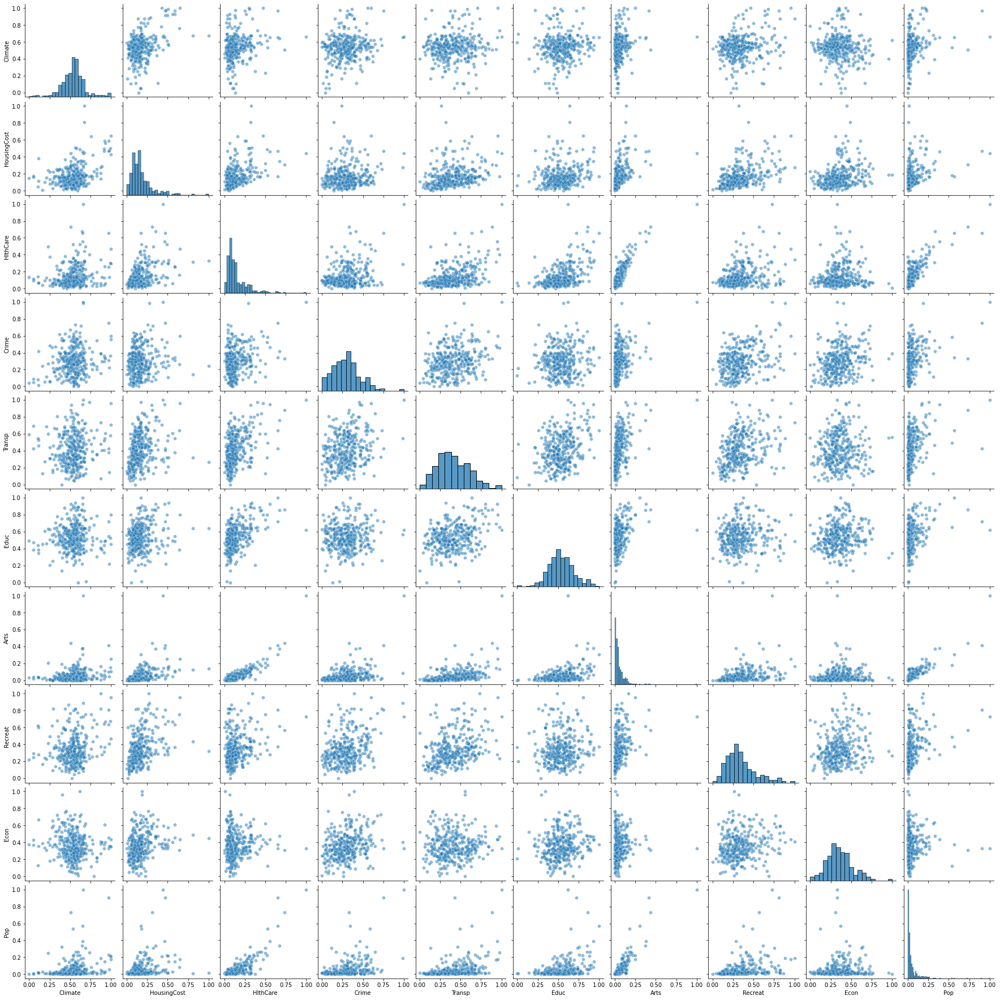

In [340]:
sns.pairplot(data_minmax, 
             plot_kws={'alpha':0.5}
            )
plt.show()

* Визуализация не особо помогла определить кластеры.  
    1) Объектов много  
    2) Не наблюдается четкого разбиения на кластеры.

In [341]:
from scipy.cluster.hierarchy import linkage, dendrogram

* Так как объектов слишком много, дендрограмма будет плохо читаема. Чтобы оценить динамику изменения расстояний на дендрограмме в таком случае можно построить график. Выбор порога можно сделать с помощью локтевого метода: выбрать ту точку, в которой снижение графика замедляется сильнее всего - "сгиб локтя".

**!
Из матрицы корреляций видно, что расстояния Минковского, Чебышева и Манхеттенских кварталов лучше всего коррелируют с Евклидовым, поэтому в дальнейшем я буду рассматривать именно их.**

In [342]:
def plot_elbow(Z, h=10, w=5):
    plt.figure(figsize=(h, w))
    plt.plot(np.array(range(1, np.shape(Z)[0]+1)), 
             Z[:,2][::-1], 
             marker='o')
    plt.xlabel("Number of clusters")
    plt.ylabel("Merge distance")
    plt.show()

## 1) Евклидово расстояние 
 ### a) Расстояние дальнего соседа (complete)


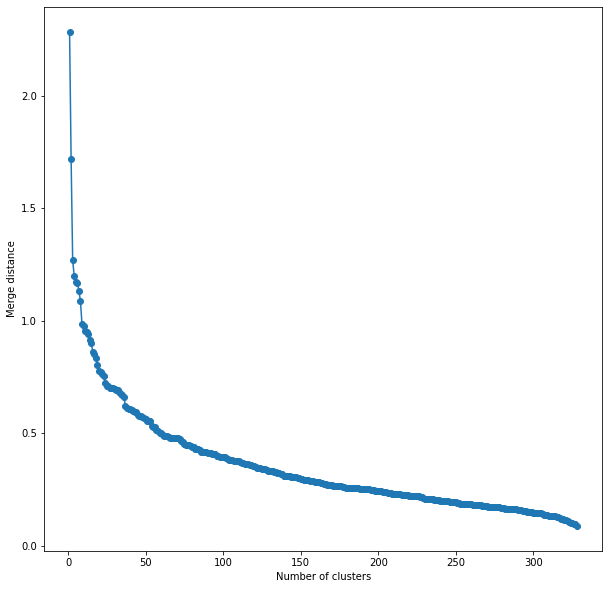

In [343]:
Z1 = linkage(data_minmax, method="complete",  metric='euclidean')
plot_elbow(Z1, w = 10)

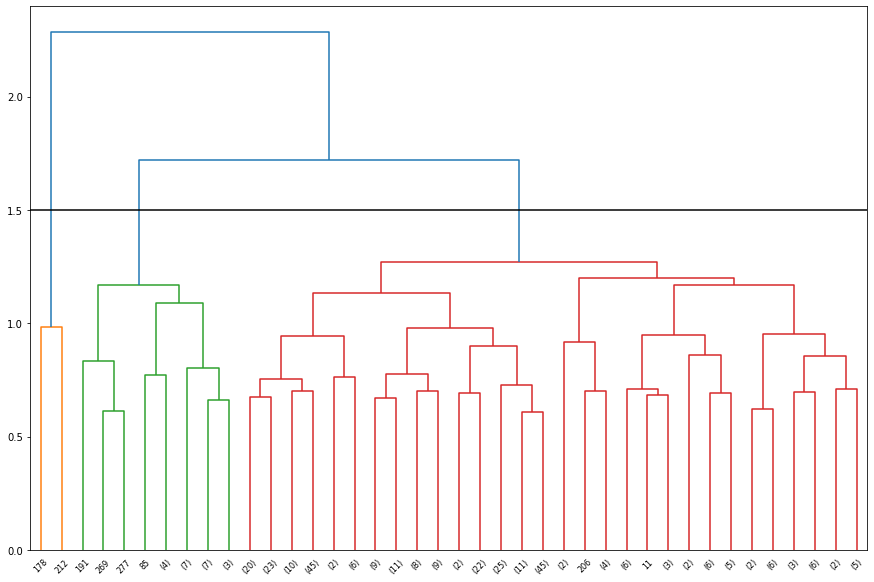

In [344]:
plt.figure(figsize=(15, 10))
dendrogram(Z1 
           ,p=40 
           ,truncate_mode='lastp' 
           ,color_threshold=1.5
          )
plt.axhline(y=1.5, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **расстояния дальнего соседа** между кластерами, я посчитала возмодным выделить **3 кластера**, так как расстояния внутри кластеров не очень большие. 

In [345]:
from scipy.cluster.hierarchy import fcluster

In [346]:
fcluster(Z1, t = 3, criterion='maxclust')

array([3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3,
       3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

 ### б) Расстояние ближайшего соседа (Single)

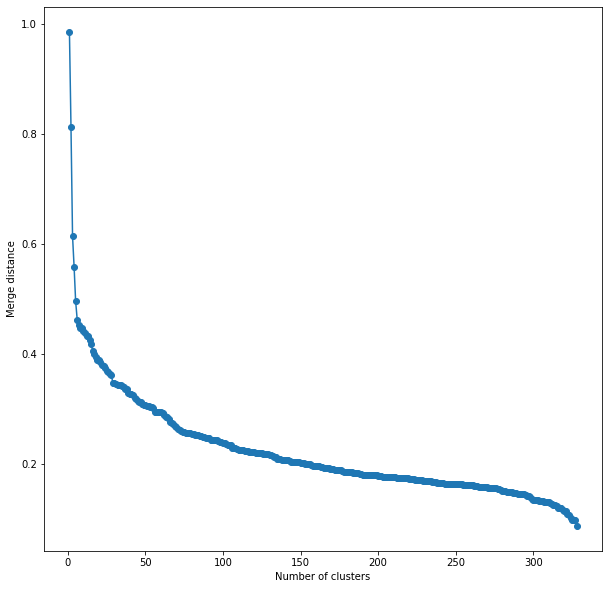

In [347]:
Z2 = linkage(data_minmax, method="single",  metric='euclidean')
plot_elbow(Z2, w = 10)

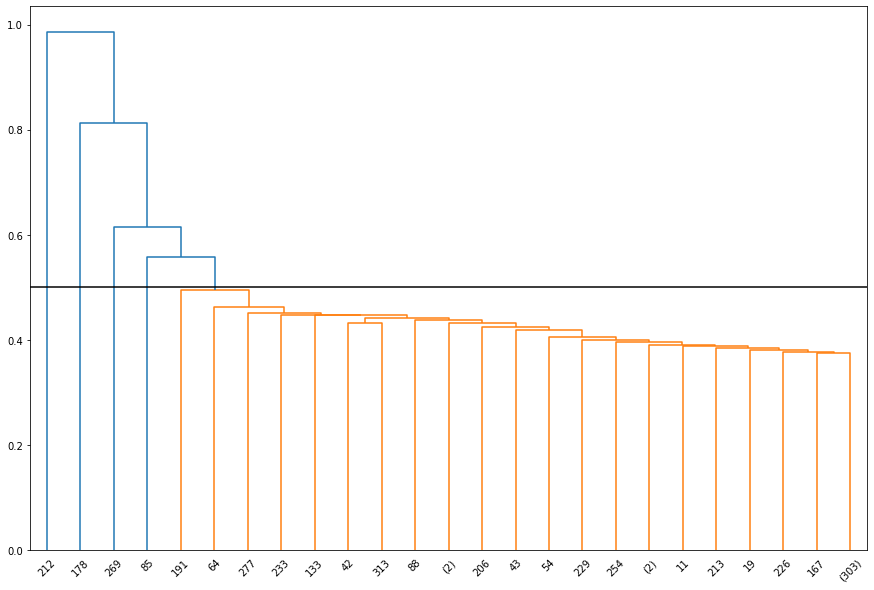

In [348]:
plt.figure(figsize=(15, 10))
dendrogram(Z2 
           ,p=25
           ,truncate_mode='lastp' 
           ,color_threshold=0.5
          )
plt.axhline(y=0.5, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **расстояния ближнего соседа** между кластерами **сложно выделить** кластеры.

 ### в) Средее расстояние (average)

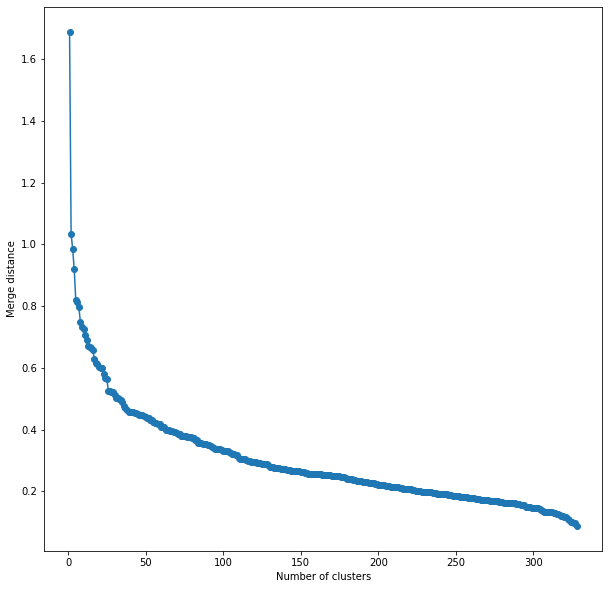

In [349]:
Z3 = linkage(data_minmax, method="average",  metric='euclidean')
plot_elbow(Z3, w = 10)

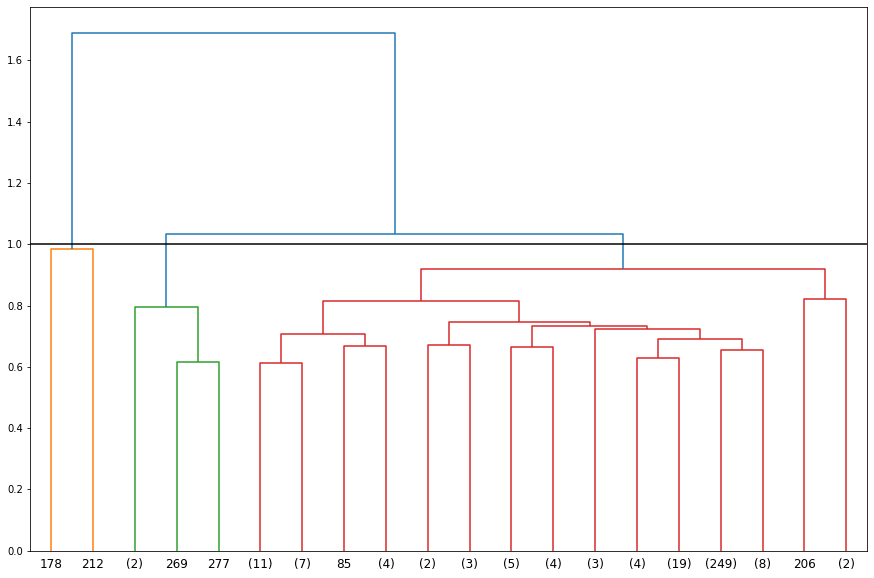

In [350]:
plt.figure(figsize=(15, 10))
dendrogram(Z3 
           ,p=20 
           ,truncate_mode='lastp' 
           ,color_threshold=1.0
          )
plt.axhline(y=1.0, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **среднего расстояния** между кластерами, я посчитала возмодным выделить **3 кластера**, так как расстояния внутри кластеров не очень большие. 
* Разбиение неудачное из-за выбранных метрик, тк 2 кластера получаются маленькими, и большее число точек попадает в один кластер.

In [351]:
fcluster(Z3, t = 3, criterion='maxclust')

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

### г) Центройдное расстояние (centroid)

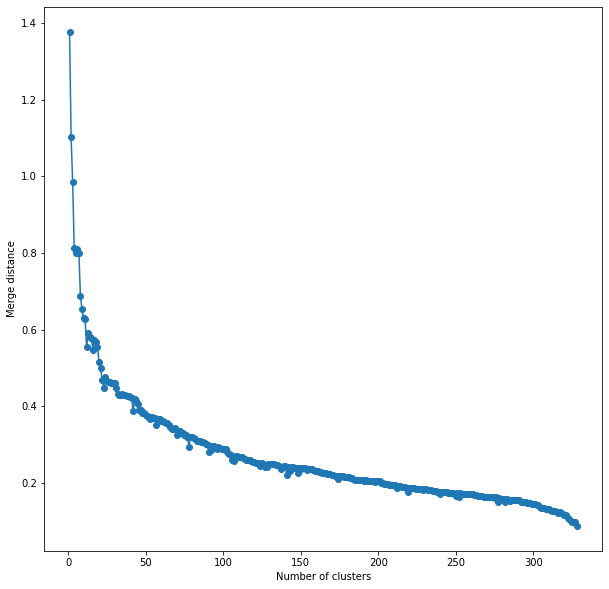

In [352]:
Z4 = linkage(data_minmax, method="centroid",  metric='euclidean')
plot_elbow(Z4, w = 10)

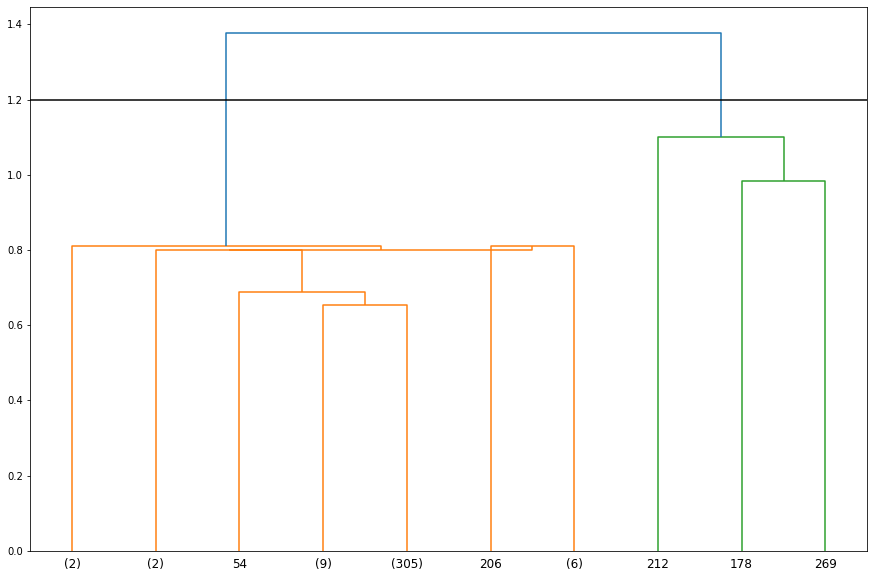

In [353]:
plt.figure(figsize=(15, 10))
dendrogram(Z4 
           ,p=10 
           ,truncate_mode='lastp' 
           ,color_threshold=1.2
          )
plt.axhline(y=1.2, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **центройдное расстояния** между кластерами, я посчитала возмодным выделить **2 кластера**, так как расстояния внутри кластеров не очень большие. При визуализации четко видны 2 кластера.

In [354]:
fcluster(Z4, t = 2, criterion='maxclust')

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

### д) Медианное расстояние (median)

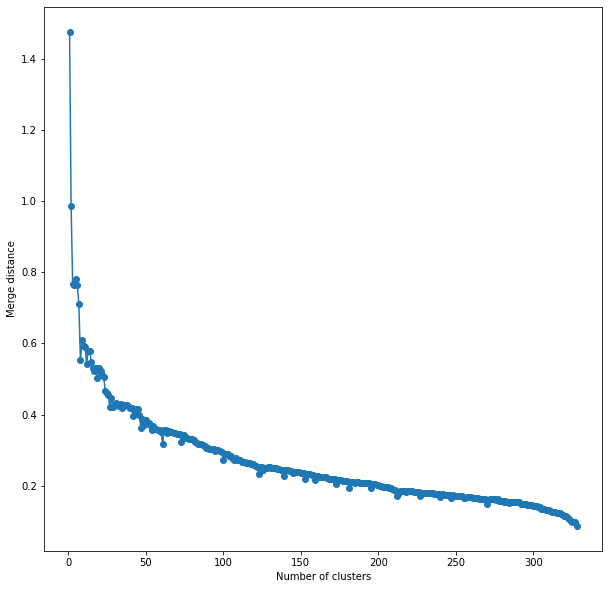

In [355]:
Z5 = linkage(data_minmax, method="median",  metric='euclidean')
plot_elbow(Z5, w = 10)

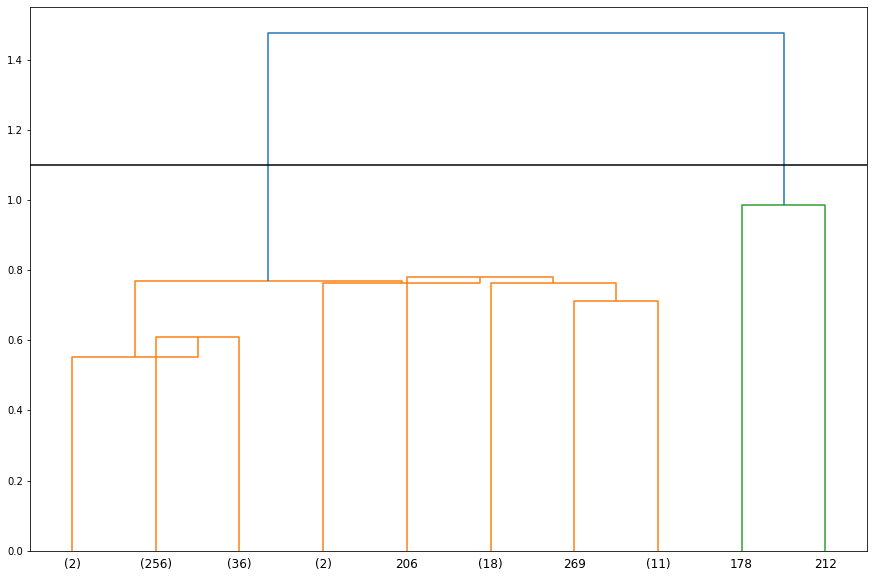

In [356]:
plt.figure(figsize=(15, 10))
dendrogram(Z5 
           ,p=10 
           ,truncate_mode='lastp' 
           ,color_threshold=1.1
          )
plt.axhline(y=1.1, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **медианного расстояния** между кластерами, я посчитала возмодным выделить **2 кластера**, так как расстояния внутри кластеров не очень большие.

In [357]:
fcluster(Z5, t = 2, criterion='maxclust')

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

### е) Метод Варда (Ward)

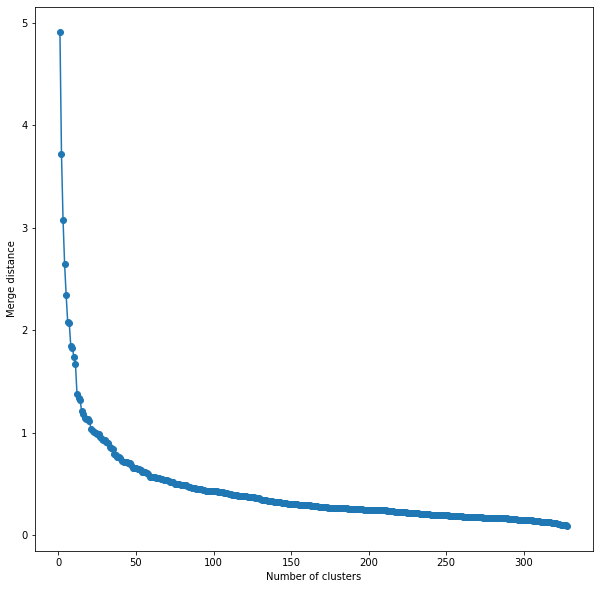

In [358]:
Z6 = linkage(data_minmax, method="ward",  metric='euclidean')
plot_elbow(Z6, w = 10)

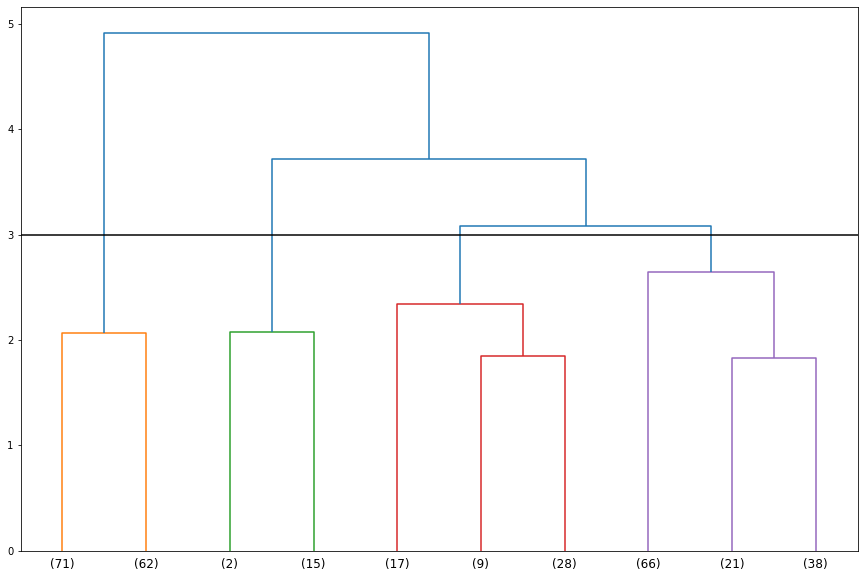

In [359]:
plt.figure(figsize=(15, 10))
dendrogram(Z6 
           ,p=10 
           ,truncate_mode='lastp' 
           ,color_threshold=3
          )
plt.axhline(y=3, c='k')
plt.show()

* Для **Евклидова расстояния** между объектами и **расстояния варда** между кластерами, я посчитала возмодным выделить **4 кластера**, так как расстояния внутри кластеров не очень большие. Разбиение получилось наиболее удачным. При визуализации четко видны 4 кластер.

In [360]:
fcluster(Z6, t = 4, criterion='maxclust')

array([4, 4, 1, 4, 4, 1, 1, 4, 1, 4, 3, 3, 1, 1, 3, 1, 1, 1, 1, 2, 4, 1,
       4, 4, 4, 2, 4, 4, 4, 4, 1, 3, 1, 3, 4, 1, 1, 4, 1, 1, 4, 4, 2, 3,
       4, 1, 3, 3, 4, 4, 1, 4, 4, 1, 3, 1, 4, 1, 4, 4, 1, 4, 4, 1, 2, 4,
       4, 1, 2, 4, 4, 4, 1, 4, 4, 1, 2, 3, 1, 1, 4, 3, 1, 2, 4, 2, 1, 1,
       1, 4, 1, 1, 1, 1, 4, 4, 3, 1, 4, 1, 4, 1, 1, 4, 1, 4, 3, 4, 3, 4,
       1, 1, 1, 4, 3, 1, 4, 3, 4, 1, 1, 1, 1, 1, 1, 4, 4, 1, 1, 4, 2, 1,
       3, 1, 2, 1, 1, 4, 1, 4, 4, 3, 1, 1, 4, 1, 1, 1, 1, 4, 1, 4, 4, 1,
       4, 1, 1, 4, 1, 4, 1, 3, 4, 1, 4, 1, 4, 3, 1, 4, 1, 1, 4, 1, 4, 4,
       4, 1, 2, 4, 4, 4, 1, 1, 4, 4, 1, 1, 1, 3, 4, 3, 3, 4, 4, 4, 2, 4,
       1, 3, 1, 1, 1, 4, 4, 4, 3, 1, 4, 4, 4, 3, 2, 3, 4, 3, 3, 3, 4, 4,
       4, 3, 4, 1, 3, 1, 3, 1, 1, 1, 4, 4, 1, 2, 4, 1, 4, 1, 3, 4, 4, 4,
       4, 1, 1, 1, 2, 1, 4, 3, 3, 4, 4, 1, 1, 4, 1, 4, 1, 1, 1, 2, 3, 3,
       3, 3, 4, 4, 3, 3, 3, 3, 3, 3, 4, 4, 1, 3, 1, 1, 1, 4, 1, 1, 4, 4,
       4, 4, 1, 3, 1, 1, 4, 4, 3, 4, 3, 1, 1, 4, 4,

### Визуализация

* Тк разбиение показалось мне более удачным, чем предыдущие, думаю стоит посмотреть на получившиеся кластеры.

In [429]:
data_ew = data_normalized.copy()

data_ew['cluster'] = fcluster(Z6, t = 4, criterion='maxclust').astype(int)
data_ew

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop,cluster
0,0.052029,0.039381,0.008419,0.049641,0.049913,0.053652,0.009797,0.038451,0.074740,0.005917,4
1,0.057421,0.051691,0.058823,0.047651,0.060463,0.047444,0.054731,0.072031,0.042594,0.035224,4
2,0.046736,0.046616,0.021952,0.052169,0.031340,0.049818,0.002331,0.023509,0.051406,0.005996,1
3,0.047535,0.050230,0.050831,0.032807,0.085228,0.066145,0.045789,0.044253,0.057418,0.044588,4
4,0.065810,0.053311,0.065821,0.079760,0.081203,0.058887,0.044225,0.071483,0.056077,0.022388,4
...,...,...,...,...,...,...,...,...,...,...,...
324,0.056123,0.055356,0.064116,0.036572,0.045109,0.064199,0.017548,0.024904,0.049350,0.021493,1
325,0.053427,0.040906,0.011260,0.059484,0.046199,0.048475,0.009797,0.058566,0.048821,0.009202,1
326,0.053926,0.053171,0.025327,0.023664,0.028071,0.056493,0.010053,0.023043,0.048430,0.020337,1
327,0.056922,0.044596,0.038967,0.050448,0.041778,0.056824,0.027513,0.036316,0.038129,0.028344,1


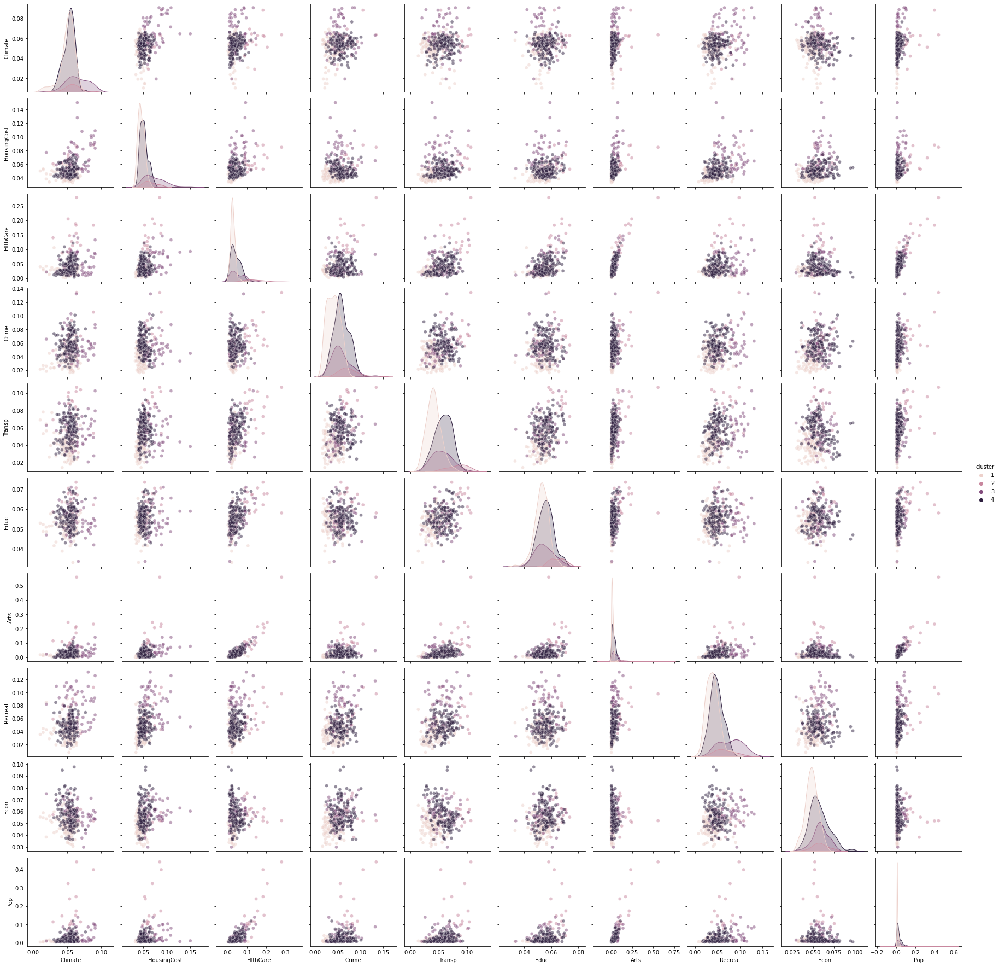

In [430]:
sns_plot = sns.pairplot(data_ew.sort_values('cluster'), 
             hue='cluster', 
             plot_kws={'alpha':0.5}, 
            )
plt.show()

## Сравнение разбиений

#### Для сравнения разбиений попарно использую матрицу сопряженности.

In [361]:
hc_complete = fcluster(linkage(data_minmax, method='complete'),
                       t=3
                       ,criterion='maxclust'
                      )

hc_average = fcluster(linkage(data_minmax, method='average'),
                       t=3,
                       criterion='maxclust'
                      )

##
hc_centroid = fcluster(linkage(data_minmax, method='centroid'),
                     t=2,
                     criterion='maxclust'
                    )

hc_median = fcluster(linkage(data_minmax, method='median'),
                     t=2,
                     criterion='maxclust'
                    )

In [362]:
pd.crosstab(hc_average, hc_complete, rownames=['hc_average'], colnames=['hc_complete'])

hc_complete,1,2,3
hc_average,,,
1,2,0,0
2,0,3,1
3,0,22,301


In [363]:
pd.crosstab(hc_centroid, hc_median, rownames=['hc_centroid'], colnames=['hc_median'])

hc_median,1,2
hc_centroid,,
1,326,0
2,1,2


* Видно, что для расстояний медианного, среднего, центроидного и дальнего соседа **не совпали.**

### Вывод (Евклидово расстояние):
 * Стоит отметить, что все разбиения получились крайне неудачными, так как выделился 1-2 больших кластера и пара очень маленьких, кроме **Метода Варда**, в котором выделилось 4 кластера. Оно значительно **отличается** от других разбиений. При визуализации можно увидеть некоторые кластеры, разбиение на первый взгляд получилось вполне неплохим.

## 2) Расстояние Манхэттенских кварталов

### a) Расстояние дальнего соседа (complete)

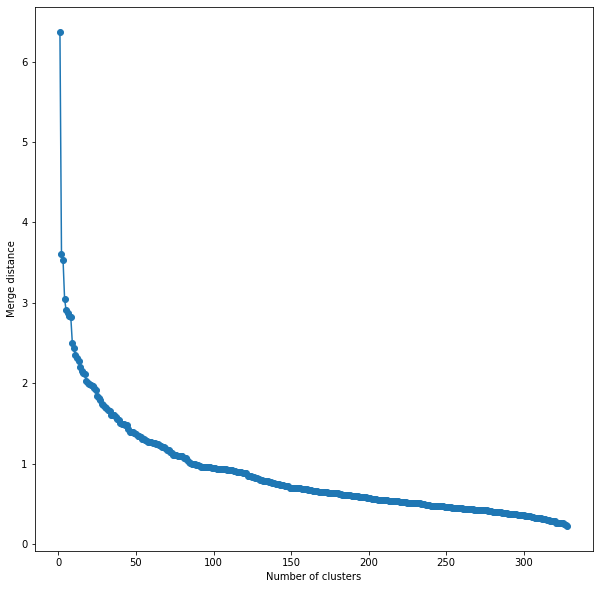

In [364]:
Z_mc = linkage(data_minmax, method="complete",  metric='cityblock')
plot_elbow(Z_mc, w = 10)

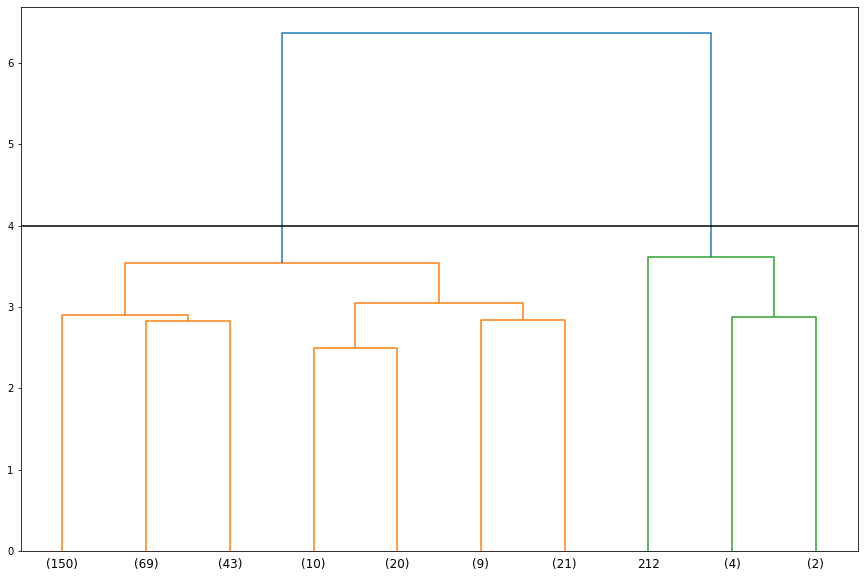

In [365]:
plt.figure(figsize=(15, 10))
dendrogram(Z_mc 
           ,p=10
           ,truncate_mode='lastp' 
           ,color_threshold=6
          )
plt.axhline(y=4, c='k')
plt.show()

* Для **Расстояние Манхэттенских** кварталов между объектами и расстояние **дальнего соседа** между кластерами, я посчитала возмодным выделить 2 кластера, так как расстояния внутри кластеров не очень большие. 
* Разбиение неудачное из-за выбранных метрик, тк один кластер получаются маленькими, и большее число точек попадает в один кластер.

In [366]:
fcluster(Z_mc, t = 2, criterion='maxclust')

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

 ### б) Расстояние ближайшего соседа (Single)

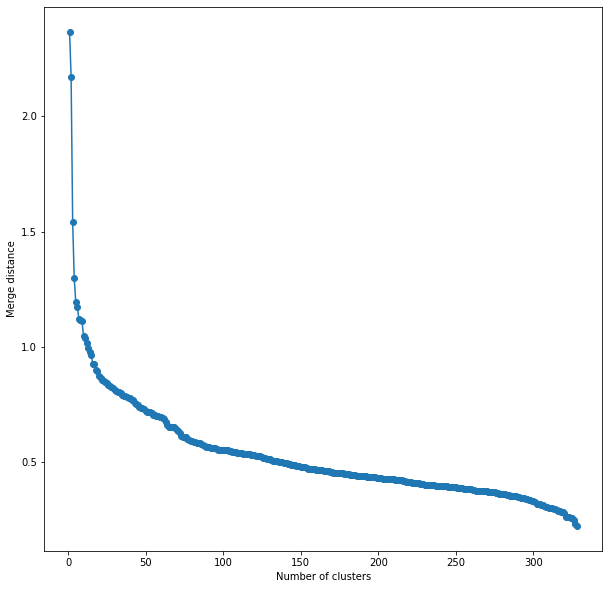

In [367]:
Z_ms = linkage(data_minmax, method="single",  metric='cityblock')
plot_elbow(Z_ms, w = 10)

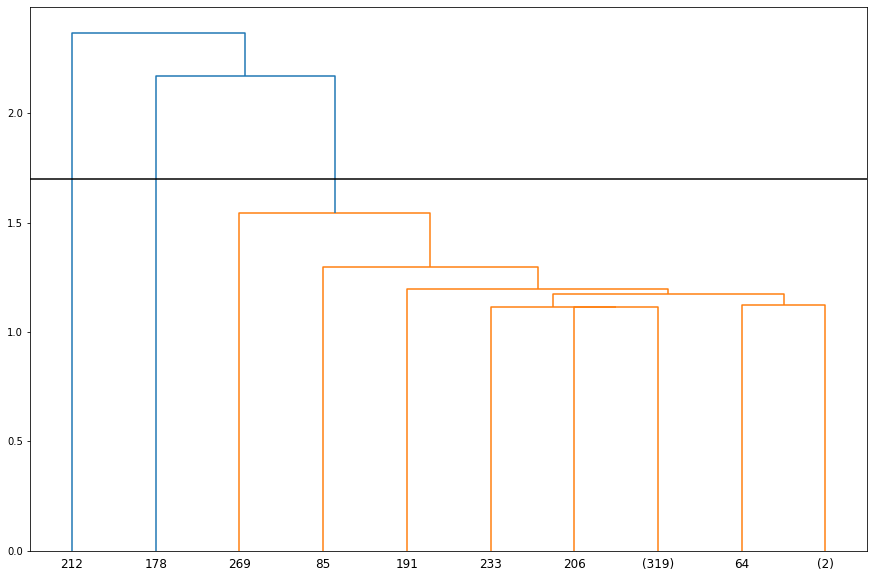

In [368]:
plt.figure(figsize=(15, 10))
dendrogram(Z_ms 
           ,p=10
           ,truncate_mode='lastp' 
           ,color_threshold=1.7
          )
plt.axhline(y=1.7, c='k')
plt.show()

* Для **Расстояние Манхэттенских** кварталов между объектами и расстояние **ближнего соседа** между кластерами, я посчитала возмодным выделить 1 кластер.
* Разбиение неудачное из-за выбранных метрик.

 ### в) Средее расстояние (average)

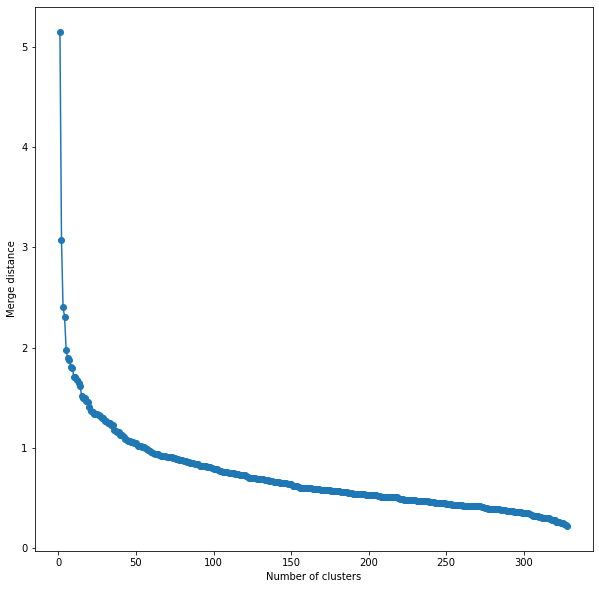

In [369]:
Z_ma = linkage(data_minmax, method="average",  metric='cityblock')
plot_elbow(Z_ma, w = 10)

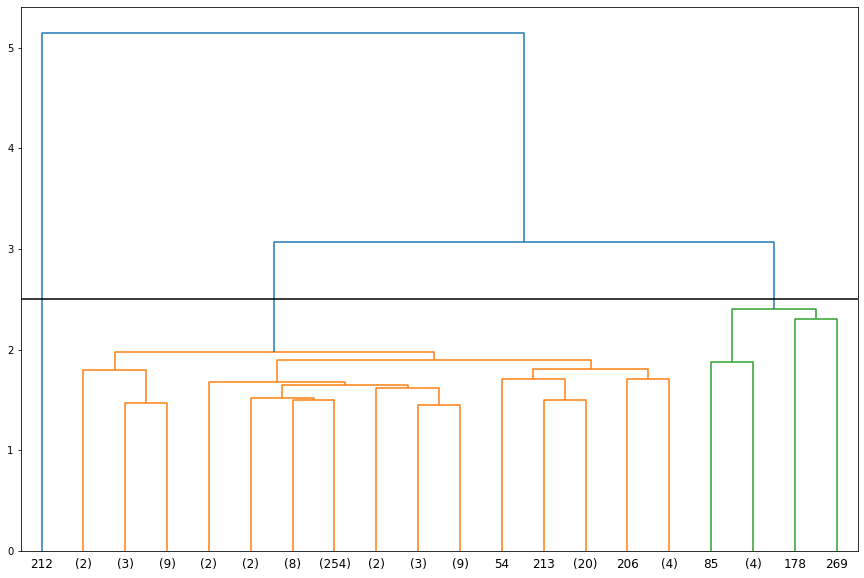

In [370]:
plt.figure(figsize=(15, 10))
dendrogram(Z_ma 
           ,p=20 
           ,truncate_mode='lastp' 
           ,color_threshold=2.5
          )
plt.axhline(y=2.5, c='k')
plt.show()

* Для **Расстояние Манхэттенских** кварталов между объектами и **среднее** расстояние между кластерами, я посчитала возмодным выделить 2 кластера, так как расстояния внутри кластеров не очень большие. 
* Разбиение неудачное из-за выбранных метрик, тк 1 кластер получаются маленькими, и большее число точек попадает в другой кластер.

In [371]:
fcluster(Z_ma, t = 2, criterion='maxclust')

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

## Сравнение разбиений (Расстояние Манхэттенских кварталов)

In [372]:
hc_complete = fcluster(linkage(data_minmax, method='complete'),
                       t=2
                       ,criterion='maxclust'
                      )

hc_average = fcluster(linkage(data_minmax, method='average'),
                       t=2,
                       criterion='maxclust'
                      )
pd.crosstab(hc_average, hc_complete, rownames=['hc_average'], colnames=['hc_complete'])

hc_complete,1,2
hc_average,,
1,2,0
2,0,327


* Видно, что для среднего расстояния и расстояния дальнего соседа разбиения **совпали**.

### Вывод (Расстояние Манхэттенских кварталов)):
 * Стоит отметить, что все разбиения получились крайне неудачными, так как выделился 1-2 больших кластера и пара очень маленьких.

## 3) Расстояние Минковского

### a) Расстояние дальнего соседа (complete)

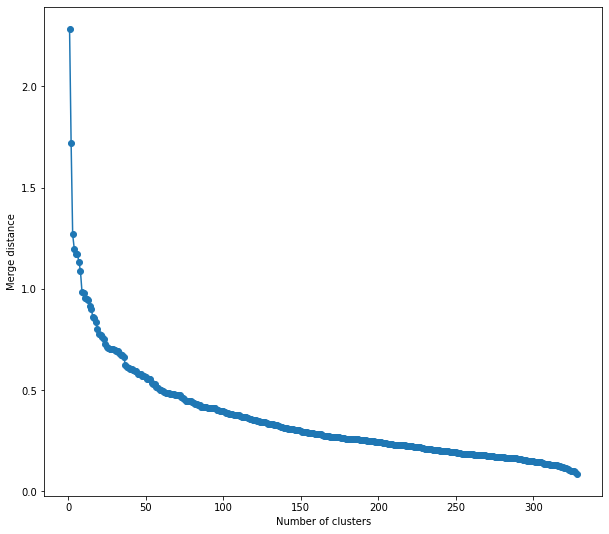

In [373]:
Z_minkc = linkage(data_minmax, method="complete",  metric='minkowski')
plot_elbow(Z_minkc, w = 9)

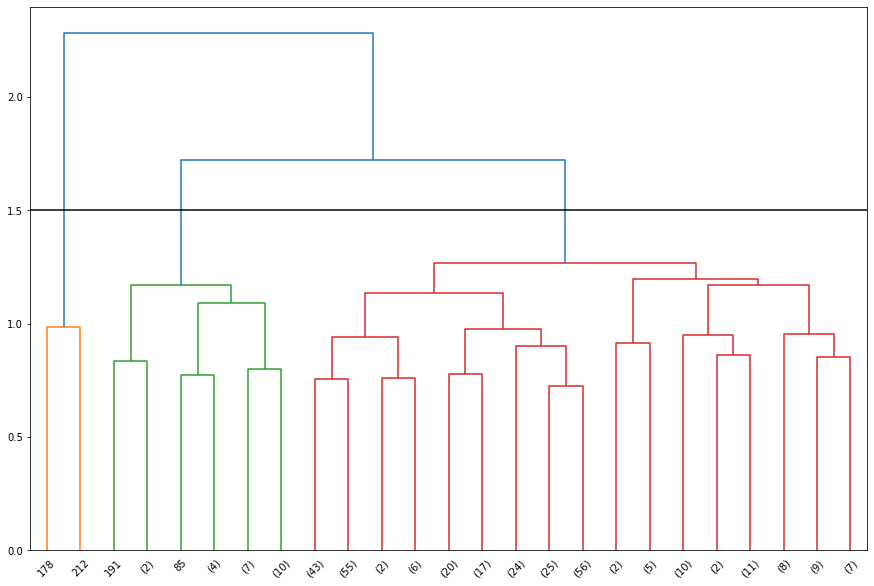

In [374]:
plt.figure(figsize=(15, 10))
dendrogram(Z_minkc 
           ,p=25
           ,truncate_mode='lastp' 
           ,color_threshold=1.5
          )
plt.axhline(y=1.5, c='k')
plt.show()


* Для **Расстояние Минковского** между объектами и расстояние **дальнего соседа** между кластерами, я посчитала возмодным выделить 3 кластера, так как расстояния внутри кластеров не очень большие.
* Разбиение неудачное из-за выбранных метрик, тк 2 кластера получаются маленькими, и большее число точек попадает в один кластер.

In [375]:
fcluster(Z_minkc, t = 3, criterion='maxclust')

array([3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3,
       3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3,
       3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 2, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 2, 3, 3, 3, 3, 3,
       2, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

 ### б) Расстояние ближайшего соседа (Single)

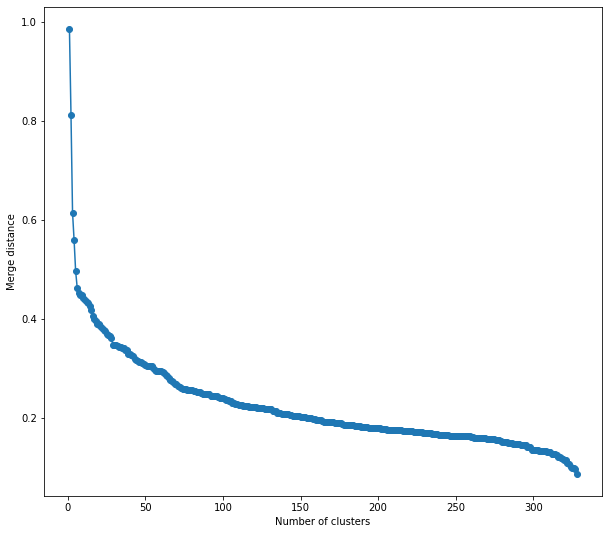

In [376]:
Z_minks = linkage(data_minmax, method="single",  metric='minkowski')
plot_elbow(Z_minks, w = 9)

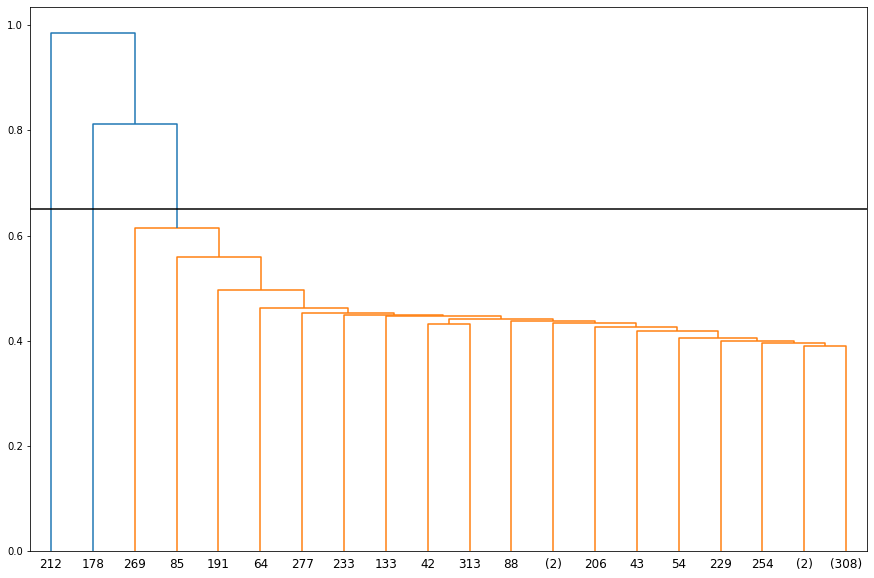

In [377]:
plt.figure(figsize=(15, 10))
dendrogram(Z_minks 
           ,p=20
           ,truncate_mode='lastp' 
           ,color_threshold=0.65
          )
plt.axhline(y=0.65, c='k')
plt.show()


* Для **Расстояние Минковского** между объектами и расстояние **ближнего соседа** между кластерами, сложно выделить кластеры.

 ### в) Средее расстояние (average)

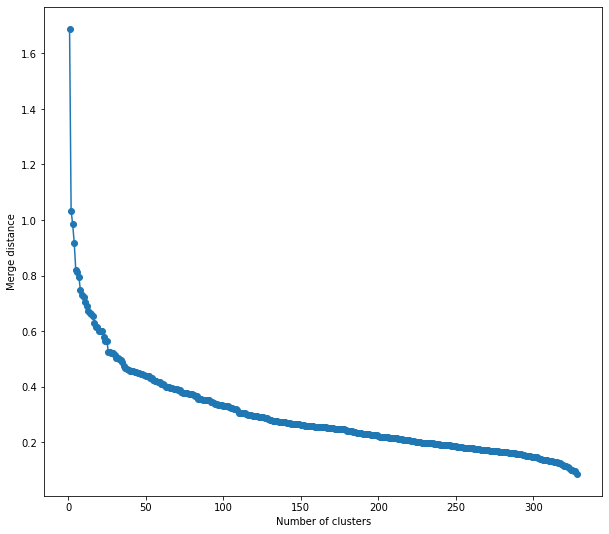

In [378]:
Z_minka = linkage(data_minmax, method="average",  metric='minkowski')
plot_elbow(Z_minka, w = 9)

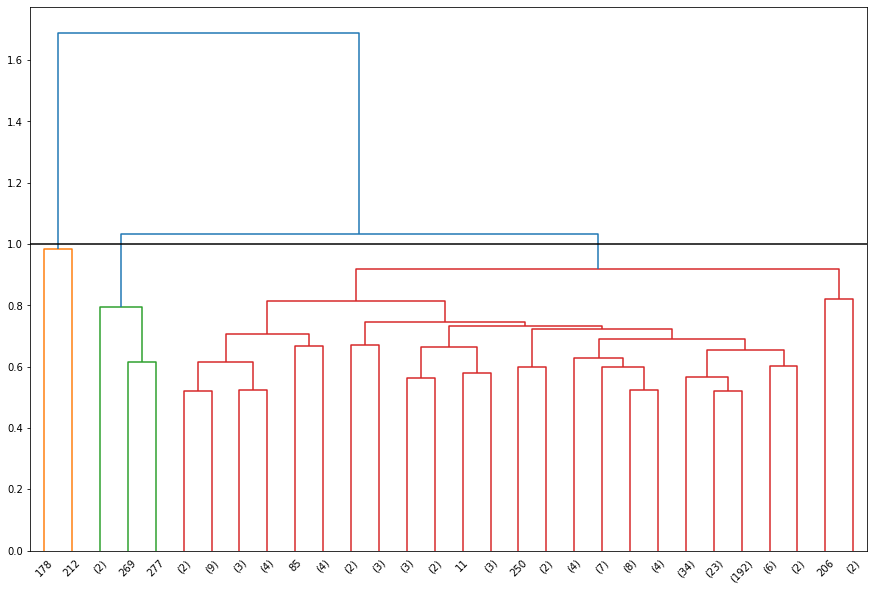

In [379]:
plt.figure(figsize=(15, 10))
dendrogram(Z_minka 
           ,p=30 
           ,truncate_mode='lastp' 
           ,color_threshold=1.0
          )
plt.axhline(y=1.0, c='k')
plt.show()


* Для **Расстояние Минковского** между объектами и **среднего** расстояния между кластерами, я посчитала возможным выделить 3 кластера, так как расстояния внутри кластеров не очень большие.
* Разбиение неудачное из-за выбранных метрик, тк 2 кластера получаются маленькими, и большее число точек попадает в один кластер.

In [380]:
fcluster(Z_minka, t = 3, criterion='maxclust')

array([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,

## Сравнение разбиений (Расстояние Минковского)

In [381]:
hc_complete = fcluster(linkage(data_minmax, method='complete'),
                     t=3
                     ,criterion='maxclust'
                    )

hc_average = fcluster(linkage(data_minmax, method='average'),
                       t=3
                       ,criterion='maxclust'
                      )

pd.crosstab(hc_average, hc_complete, rownames=['hc_average'], colnames=['hc_complete'])

hc_complete,1,2,3
hc_average,,,
1,2,0,0
2,0,3,1
3,0,22,301


* Видно, что для расстояний дальнего соседа и среднего разбиения **не совпали.**

### Вывод (Расстояние Минковского):
 * Стоит отметить, что все разбиения получились крайне неудачными, так как выделился 1-2 больших кластера и пара очень маленьких.

## 4) Расстояние Чебышева

### a) Расстояние дальнего соседа (complete)

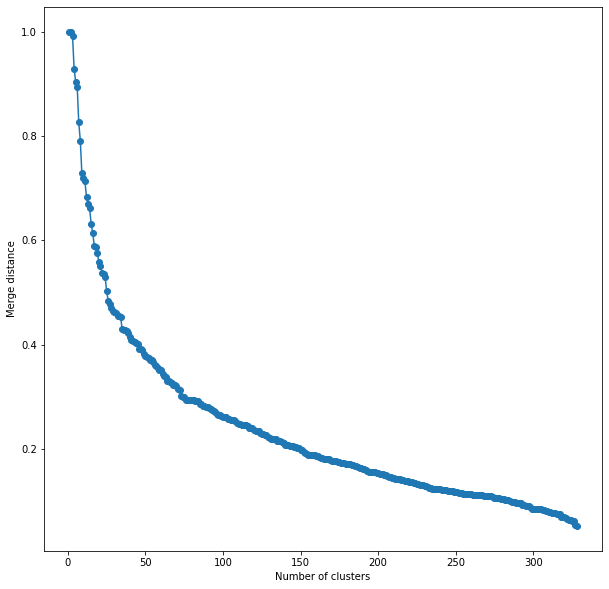

In [382]:
Z_chc = linkage(data_minmax, method="complete",  metric='chebyshev')
plot_elbow(Z_chc, w = 10)

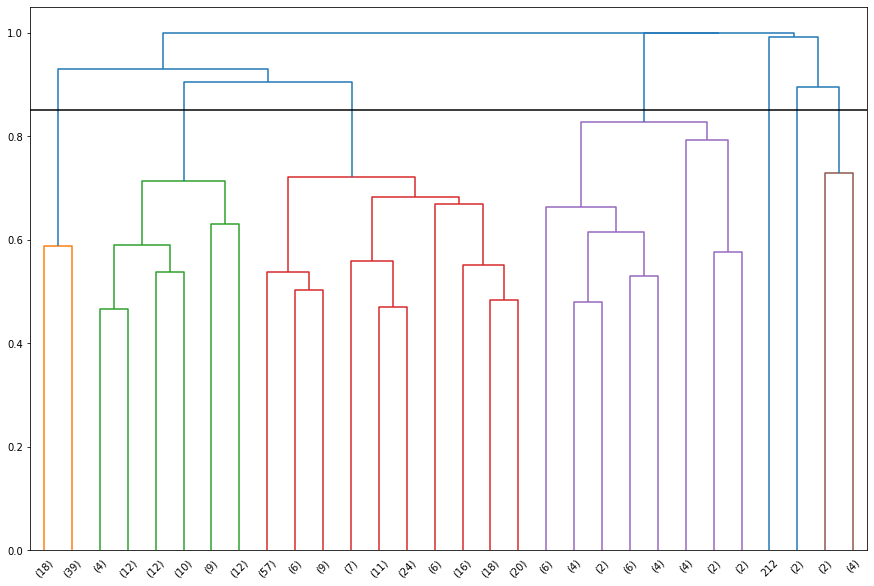

In [383]:
plt.figure(figsize=(15, 10))
dendrogram(Z_chc 
           ,p=30
           ,truncate_mode='lastp' 
           ,color_threshold=0.85
          )
plt.axhline(y=0.85, c='k')
plt.show()

* Для **Расстояние Чебышева** между объектами и расстояние **дальнего соседа** между кластерами, я посчитала возможным выделить 5 кластеров, так как расстояния внутри кластеров не очень большие. 
* Разбиение не ососбо удачное, тк 3 кластера получаются маленькими, и большее число точек попадает в 2 других кластера.

In [384]:
fcluster(Z_chc, t = 5, criterion='maxclust')

array([2, 2, 2, 2, 2, 1, 1, 1, 1, 2, 3, 2, 2, 1, 2, 2, 2, 1, 2, 2, 3, 1,
       2, 2, 2, 2, 2, 2, 2, 2, 1, 3, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 4, 1,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 3, 2, 2, 2, 4, 2, 2,
       2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 2, 3, 2, 2, 3,
       1, 2, 2, 2, 3, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 1,
       3, 3, 3, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 2, 1, 2, 2, 2, 2, 2,
       2, 2, 1, 2, 2, 3, 2, 2, 2, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 1, 4, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 3, 2, 4, 2, 2, 3, 2, 2, 2,
       2, 3, 2, 2, 1, 2, 2, 2, 3, 2, 2, 2, 2, 2, 5, 3, 2, 3, 4, 3, 2, 2,
       2, 1, 2, 2, 2, 2, 3, 2, 1, 3, 1, 2, 2, 4, 2, 2, 2, 1, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 1,
       3, 2, 2, 2, 3, 4, 3, 3, 1, 1, 2, 2, 1, 3, 1, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 4, 1, 1, 2, 2, 3, 2, 2, 1, 2, 2, 2,

 ### б) Расстояние ближайшего соседа (Single)

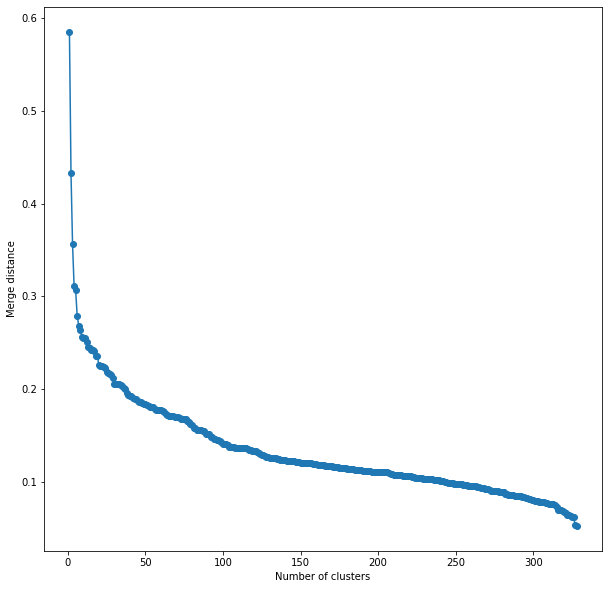

In [385]:
Z_chs = linkage(data_minmax, method="single",  metric='chebyshev')
plot_elbow(Z_chs, w = 10)

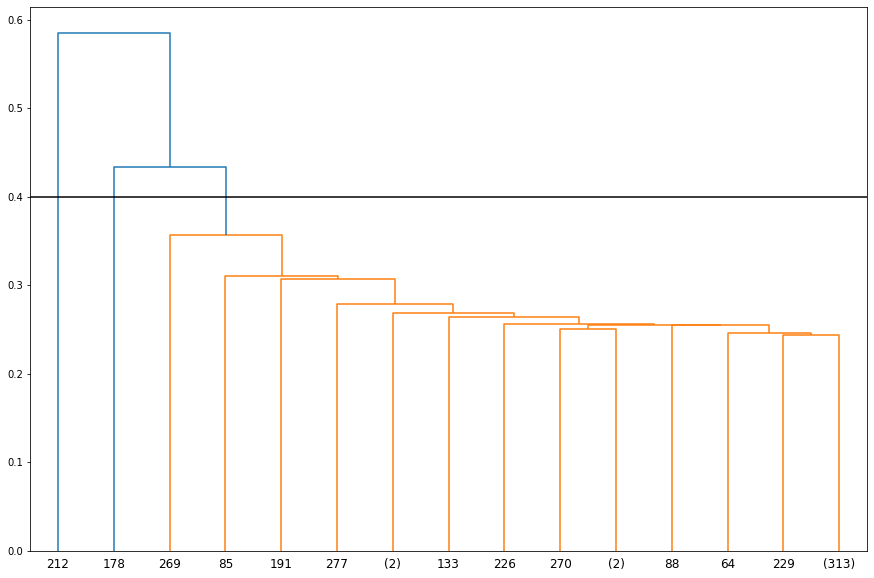

In [386]:
plt.figure(figsize=(15, 10))
dendrogram(Z_chs 
           ,p=15
           ,truncate_mode='lastp' 
           ,color_threshold=0.4
          )
plt.axhline(y=0.4, c='k')
plt.show()

* Для **Расстояние Чебышева** между объектами и расстояние **ближнего соседа** между кластерами,думаюсложно выделить кластеры.

 ### в) Средее расстояние (average)

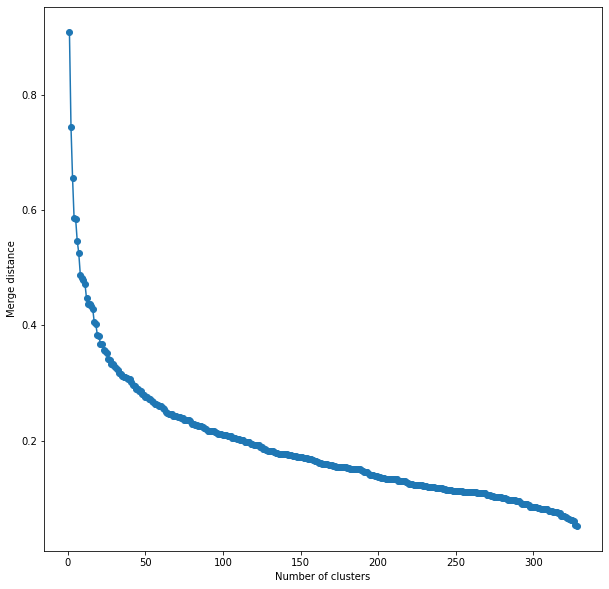

In [387]:
Z_cha = linkage(data_minmax, method="average",  metric='chebyshev')
plot_elbow(Z_cha, w = 10)

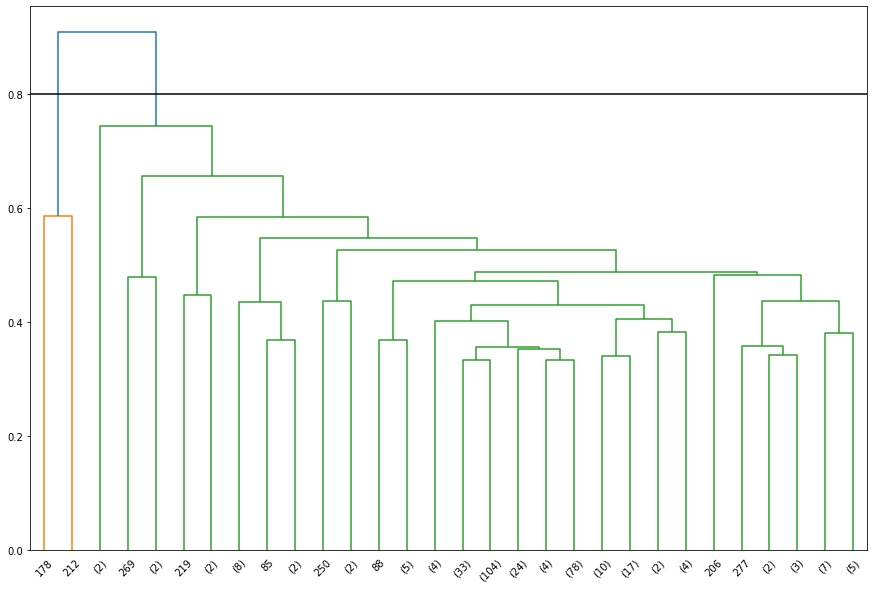

In [388]:
plt.figure(figsize=(15, 10))
dendrogram(Z_cha 
           ,p=30
           ,truncate_mode='lastp' 
           ,color_threshold=0.8
          )
plt.axhline(y=0.8, c='k')
plt.show()

* Для **Расстояние Чебышева** между объектами и **среднего** расстояния между кластерами, я посчитала возможным выделить 2 кластера, так как расстояния внутри кластеров не очень большие. 
* Разбиение неудачное, тк 1 кластер получается маленьким, и большее число точек попадает в другой кластер.

### Вывод (Расстояние Чебышева):
 * Стоит отметить, что все разбиения получились крайне неудачными, так как выделился 1-2 больших кластера и пара очень маленьких.

### Общий вывод:
* В общем и целом, иерархическая кластеризация показала неплохой результат лишь при **евклидовом расстоянии и методе варда**, остальные разбиения я считаю крайне неудачными.

# 3. Dbscan.

In [389]:
# Выполните кластеризацию методом Dbscan. Используйте расстояния между объектами, определенные в предыдущем пункте. 
# Реализуйте эвристику (см. лекции) для выбора параметров алгоритма. Подберите подходящие параметры алгоритма.

* Здесь я решила попробовать другой алгоритм и привести данные к единичной Евклидовой норме.

In [390]:
data_normalized = pd.DataFrame(preprocessing.normalize(data_copy, norm='l2', axis=0), 
                                columns=data_copy.columns)
np.linalg.norm(data_normalized, axis=0)

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

### Эвристика для выбора параметров

#### MinPts
* Нет автоматического способа определения значения MinPts для DBSCAN. В конечном итоге значение MinPts должно быть установлено с учетом знаний предметной области и знания набора данных. 

#### Эпсилон (ε)
* Можно реализовать метод автоматического определения оптимального значения **ε**. Этот метод вычисляет среднее расстояние между каждой точкой и ее ближайшими соседями k, где k = выбранное значение MinPts. Затем средние k-расстояния наносятся в порядке возрастания на график k-расстояний. Оптимальное значение для ε будет в точке максимальной кривизны (т.е. там, где график имеет наибольший наклон).

In [391]:
from sklearn.neighbors import NearestNeighbors 

* Чтобы вычислить среднее расстояние между каждой точкой и ее n_neighbors, я использовала NearestNeighbors из Scikit-learn. 
* Параметр, который мы определяем сами - это n_neighbors, который в данном случае является значением, которое мы выбираете для MinPts.

In [392]:
neighbors = NearestNeighbors(n_neighbors=3)
neighbors_fit = neighbors.fit(data_normalized)
distances, indices = neighbors_fit.kneighbors(data_normalized)

* Для данного набора данных отсортированные расстояния дают график локального расстояния k:

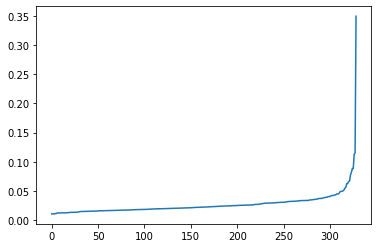

In [393]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

* Лучшее значение для **ε** будет равно значению расстояния на «изгибе локтя» или точке максимальной кривизны. 
* Eps можно выбрать от **0.05** до **0.11**

### Кластеризация методом DBSCAN

In [394]:
from sklearn.cluster import DBSCAN

### 1) Евклидово расстояние

In [395]:
cl_dbscan_euc = DBSCAN(eps=0.05, min_samples=3, metric='euclidean')

cl_dbscan_euc.fit(data_normalized)
pd.Series(cl_dbscan_euc.labels_).value_counts()

 0    308
-1     17
 1      4
dtype: int64

#### Визуализация

In [396]:
dbscan_euc = data_copy.copy()

dbscan_euc['points'] = 'Reachable'
dbscan_euc.iloc[cl_dbscan_euc.core_sample_indices_, 10] = 'Core'
dbscan_euc.loc[cl_dbscan_euc.labels_ == -1, 'points'] = 'Outlier'

In [397]:
sns.pairplot(hue='points',
             data=dbscan_euc, 
             height=10)
plt.show()

### Вывод:
* Для **Евклидова расстояния** между объектами алгоритмом получилось выделить 2 кластера и выбросы.
* Разбиение не особо удачное, тк один кластер получился очень маленьким, и большее число точек попало в другой кластер.


### 2) Расстояние Манхэттенских кварталов

In [398]:
cl_dbscan_cb = DBSCAN(eps=0.11, min_samples=3, metric='cityblock')
cl_dbscan_cb.fit(data_normalized)
pd.Series(cl_dbscan_cb.labels_).value_counts()

 0    300
-1     23
 2      3
 1      3
dtype: int64

#### Визуализация

In [399]:
dbscan_cb = data_copy.copy()

dbscan_cb['points'] = 'Reachable'
dbscan_cb.iloc[cl_dbscan_cb.core_sample_indices_, 10] = 'Core'
dbscan_cb.loc[cl_dbscan_cb.labels_ == -1, 'points'] = 'Outlier'

In [400]:
sns.pairplot(hue='points',
             data=dbscan_cb, 
             height=10)
plt.show()

### Вывод:
* Для **Расстояния Манхэттенских кварталов** между объектами, алгоритмом получилось выделить 3 кластера и выбросы.
* Разбиение не особо удачное, тк два кластера получились очень маленьким, и большее число точек попало в один кластер.

### 3) Расстояние Минковского 

In [401]:
cl_dbscan_mink = DBSCAN(eps=0.08, min_samples=3, metric='minkowski', p=5)

cl_dbscan_mink.fit(data_normalized)
pd.Series(cl_dbscan_mink.labels_).value_counts()

 0    326
-1      3
dtype: int64

### Вывод:
* Для **Расстояния Минковского** между объектами, алгоритмом получилось выделить 1 кластер и выбросы.
* Разбиение неудачное, тк почти все точки попали в один кластер.

### 4) Расстояние Чебышева

In [402]:
cl_dbscan_cheb = DBSCAN(eps=0.09, min_samples=3, metric='chebyshev')

cl_dbscan_cheb.fit(data_normalized)
pd.Series(cl_dbscan_cheb.labels_).value_counts()

 0    328
-1      1
dtype: int64

### Вывод:
* Для **Расстояния Чебышева** между объектами, алгоритмом получилось выделить 1 кластер и выброс.
* Разбиение неудачное, тк почти все точки попали в один кластер.

###  Общий вывод:
* DBSCAN плохо подходит для кластеризации представленных данных.

# 4.  KMeans

In [403]:
# Выполните кластеризацию методом kmeans.
# Определите наилучшее (на ваш взгляд) число кластеров.

In [404]:
from sklearn.cluster import KMeans

### Выбор числа кластеров

* Запускаю алгоритм на различном числе кластеров, далее локтевым методом выбираю подходящее число кластеров.

In [405]:
inertia = []
for k in range(1, 50):
    Z = KMeans(n_clusters=k, 
               init = 'random',
               n_init = 100,
               max_iter = 1000).fit(data_normalized)
    inertia.append(Z.inertia_)

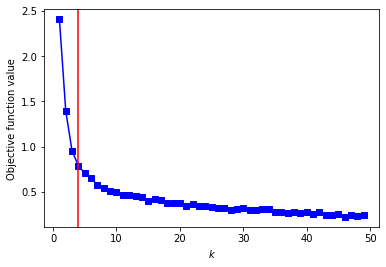

In [406]:
plt.plot(range(1, 50), inertia, 'bo-', marker='s')
plt.xlabel('$k$')
plt.ylabel('Objective function value')
plt.axvline(x=4, c='r')
plt.show()

* Думаю, что наиболее подходящим числом кластеров будет 4. Сравнивала результаты разбиений по метрикам качества (Силуэт и Дэвиса-Болдина)

In [407]:
Z = KMeans(n_clusters = 4 # число кластеров
           ,init = 'random'
           ,n_init = 1
           ,max_iter = 100 
           ,random_state=15434
          ,)
Z.fit(data_normalized)

KMeans(init='random', max_iter=100, n_clusters=4, n_init=1, random_state=15434)

In [408]:
pd.Series(Z.labels_).value_counts()

2    156
0    116
3     50
1      7
dtype: int64

In [409]:
# координты центров кластеров
Z.cluster_centers_

array([[0.05368781, 0.05447741, 0.03743678, 0.058797  , 0.05819223,
        0.05429364, 0.02662563, 0.05971548, 0.05594347, 0.02005766],
       [0.0635845 , 0.07287064, 0.19146532, 0.08198019, 0.08218341,
        0.06567541, 0.24670181, 0.07619452, 0.05292549, 0.28252131],
       [0.05119475, 0.04598276, 0.02399856, 0.04179432, 0.04206649,
        0.05305563, 0.01010408, 0.03712061, 0.0517585 , 0.00949315],
       [0.06081686, 0.06878777, 0.08860951, 0.0618232 , 0.06526092,
        0.05975178, 0.07610593, 0.06739092, 0.05731057, 0.06755526]])

In [410]:
# Значение целевой функции:
# сумма квадратов расстояний от объекта до центра кластера, 
# к которому он принаджлежит
Z.inertia_

0.8409648909315113

* Добавляю к данным координаты центров калстеров, чтобы отобразить их на графике.

In [411]:
data_kmeans = data_normalized.copy()

data_kmeans['cluster'] = Z.labels_.astype(int)
data_kmeans

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop,cluster
0,0.052029,0.039381,0.008419,0.049641,0.049913,0.053652,0.009797,0.038451,0.074740,0.005917,2
1,0.057421,0.051691,0.058823,0.047651,0.060463,0.047444,0.054731,0.072031,0.042594,0.035224,0
2,0.046736,0.046616,0.021952,0.052169,0.031340,0.049818,0.002331,0.023509,0.051406,0.005996,2
3,0.047535,0.050230,0.050831,0.032807,0.085228,0.066145,0.045789,0.044253,0.057418,0.044588,0
4,0.065810,0.053311,0.065821,0.079760,0.081203,0.058887,0.044225,0.071483,0.056077,0.022388,0
...,...,...,...,...,...,...,...,...,...,...,...
324,0.056123,0.055356,0.064116,0.036572,0.045109,0.064199,0.017548,0.024904,0.049350,0.021493,2
325,0.053427,0.040906,0.011260,0.059484,0.046199,0.048475,0.009797,0.058566,0.048821,0.009202,2
326,0.053926,0.053171,0.025327,0.023664,0.028071,0.056493,0.010053,0.023043,0.048430,0.020337,2
327,0.056922,0.044596,0.038967,0.050448,0.041778,0.056824,0.027513,0.036316,0.038129,0.028344,2


#### Визуализация

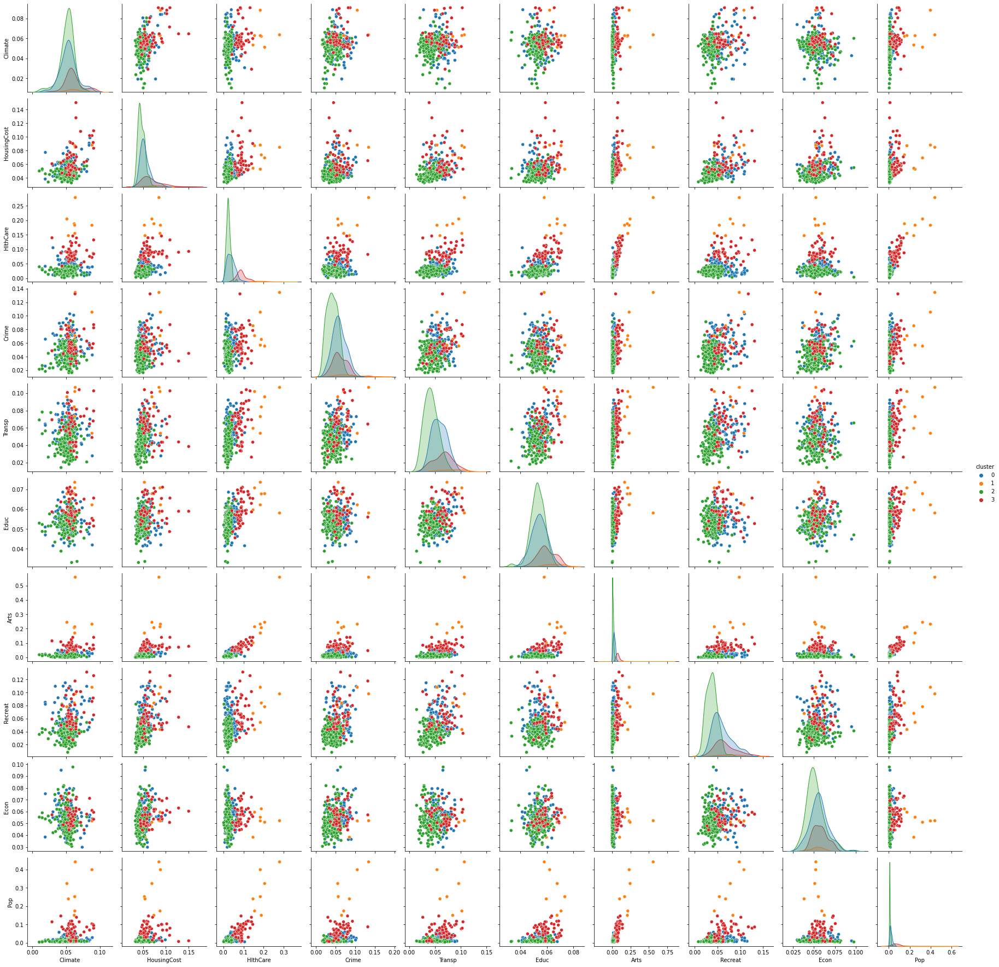

In [169]:
sns_plot = sns.pairplot(
            data_kmeans.sort_values('cluster')
            ,hue='cluster'    
            ,palette = 'tab10'
            )
plt.show()
# сохраняю отдельно картинку
sns_plot.savefig("output_kmeans.png")

 ### Вывод:
* Кластеризация оказалась вполне успешной. Выделилось 4 кластера. Один из кластеров оказался малочисленным в разбиении, тк содержит в себе всего 7 элементов. Четкое разделение между кластерами видно на pairplot.

# 5) Kластеризация другим методом. 
## SpectralClustering

In [412]:
# (Бонусное) Выполните кластеризацию другими методами. 
# Например, HDBSCAN или алгоритмы, реализованные в scikit-learn.

* Попробовав разные алгоритмы из scikit-learn, я пришла к выводу, 
  что самые адекватные результаты появляются в **Спектральной кластеризации**.
   
  
* Техники спектральной кластеризации используют спектр (собственные значения) матрицы сходства данных для осуществления снижения размерности перед кластеризацией в пространствах меньших размерностей. Матрица сходства подаётся в качестве входа и состоит из количественных оценок относительной схожести каждой пары точек в данных.

In [413]:
from sklearn.cluster import SpectralClustering

In [414]:
clustering = SpectralClustering(n_clusters=5,
      assign_labels="discretize",
       random_state=0).fit(data_normalized)

pd.Series(clustering.labels_).value_counts().sort_index()

0    113
1     82
2     71
3     44
4     19
dtype: int64

#### Визуализация

In [415]:
data_sc = data_normalized.copy()

data_sc['cluster'] = clustering.labels_.astype(str)
data_sc

,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop,cluster
0,0.052029,0.039381,0.008419,0.049641,0.049913,0.053652,0.009797,0.038451,0.074740,0.005917,1
1,0.057421,0.051691,0.058823,0.047651,0.060463,0.047444,0.054731,0.072031,0.042594,0.035224,3
2,0.046736,0.046616,0.021952,0.052169,0.031340,0.049818,0.002331,0.023509,0.051406,0.005996,0
3,0.047535,0.050230,0.050831,0.032807,0.085228,0.066145,0.045789,0.044253,0.057418,0.044588,2
4,0.065810,0.053311,0.065821,0.079760,0.081203,0.058887,0.044225,0.071483,0.056077,0.022388,2
...,...,...,...,...,...,...,...,...,...,...,...
324,0.056123,0.055356,0.064116,0.036572,0.045109,0.064199,0.017548,0.024904,0.049350,0.021493,2
325,0.053427,0.040906,0.011260,0.059484,0.046199,0.048475,0.009797,0.058566,0.048821,0.009202,1
326,0.053926,0.053171,0.025327,0.023664,0.028071,0.056493,0.010053,0.023043,0.048430,0.020337,0
327,0.056922,0.044596,0.038967,0.050448,0.041778,0.056824,0.027513,0.036316,0.038129,0.028344,0


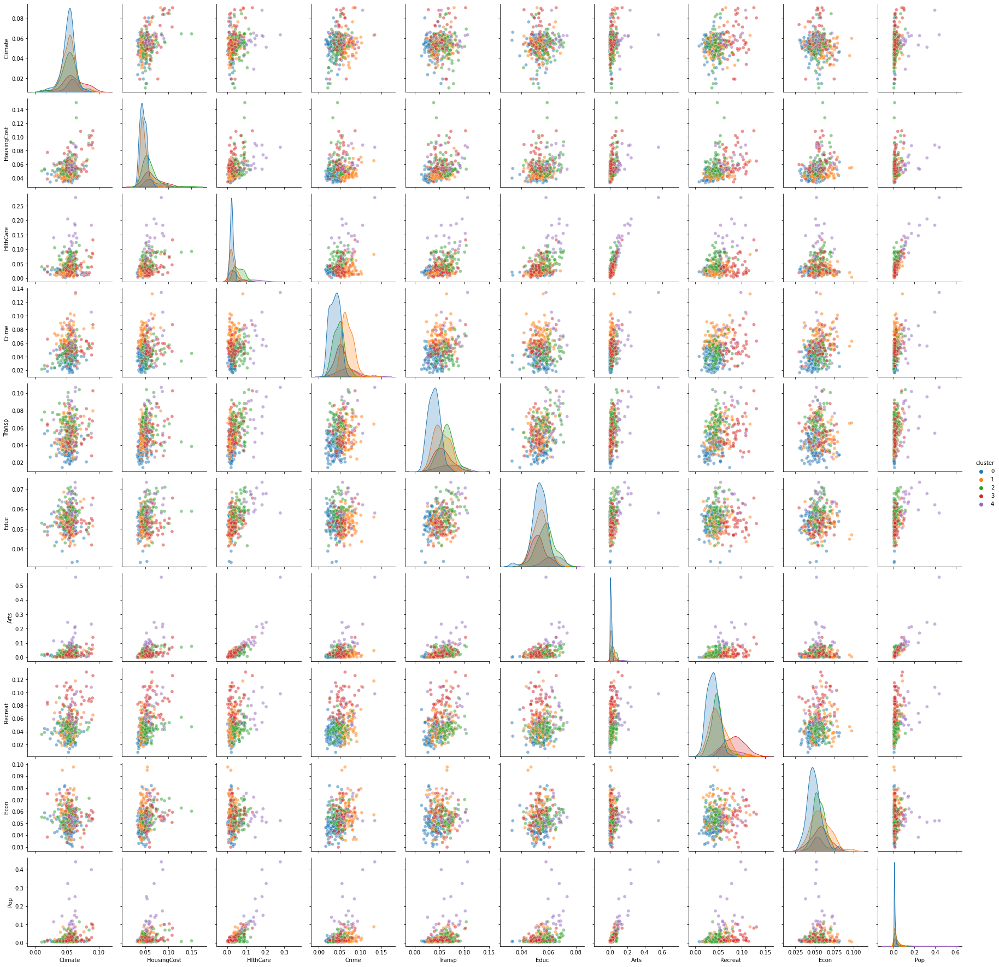

In [303]:
sns_plot = sns.pairplot(data_sc.sort_values('cluster'), 
             hue='cluster', 
             plot_kws={'alpha':0.5}, 
            
            )
plt.show()
# сохраняю картинку
sns_plot.savefig("output_sc.png")

 ### Вывод:
* Спектральная кластеризация показала хорошее разбиение на кластеры. Наилучшим решением, я посчитала разбить данные на 5 кластеров. На pairplot хуже видно четкое разграничение между кластерами, в отличие от к-средних, но здесь и кластеров на один больше.

# 6. Сравнение различных методов кластеризации.

In [416]:
# В результате выполнения предыдущих пунктов вы должны получить 4 
# или больше разбиений объектов (по одному на каждый метод).
# Сравните их между собой, сделайте выводы о сходствах и различиях.
# Оцените результаты каждой кластеризации, используя метрики, рассмотренные 
# на занятиях (Silhouette и прочие).

### Сравнение полученных  разбиений объектов между собой,  выводы об их сходствах и различиях.

* **Иерархическая кластеризация** хуже подходит для кластеризации больших объемов данных в сравнении с методом **k-средних**. Это объясняется тем, что временная сложность алгоритма линейна для метода k-средних (O(n)) и квадратична для метода иерархической кластеризации (O(n2))

* В кластеризации при помощи метода k-средних алгоритм начинает построение с произвольного выбора начальных точек, поэтому, результаты, генерируемые при многократном запуске алгоритма, могут отличаться.

#### Dbscan -- Расстояние Манхэттенских кварталов

In [417]:
pd.Series(cl_dbscan_cb.labels_).value_counts()

 0    300
-1     23
 2      3
 1      3
dtype: int64

### Вывод:
* На данном наборе данных, такой метод кластеризации как **DBSCAN**, плохо справился с выделением кластерой структуры и основное кол-во точек попали в один кластер.

* **DBSCAN** выделял 3-4 кластера, но по разбиению объектов, этот тип кластеризаци был также неэффективен. 

#### Евклидово расстояние между объектами и метод Варда между кластерами.

In [418]:
euc_ward = fcluster(Z6, t = 4, criterion='maxclust')
euc_ward

array([4, 4, 1, 4, 4, 1, 1, 4, 1, 4, 3, 3, 1, 1, 3, 1, 1, 1, 1, 2, 4, 1,
       4, 4, 4, 2, 4, 4, 4, 4, 1, 3, 1, 3, 4, 1, 1, 4, 1, 1, 4, 4, 2, 3,
       4, 1, 3, 3, 4, 4, 1, 4, 4, 1, 3, 1, 4, 1, 4, 4, 1, 4, 4, 1, 2, 4,
       4, 1, 2, 4, 4, 4, 1, 4, 4, 1, 2, 3, 1, 1, 4, 3, 1, 2, 4, 2, 1, 1,
       1, 4, 1, 1, 1, 1, 4, 4, 3, 1, 4, 1, 4, 1, 1, 4, 1, 4, 3, 4, 3, 4,
       1, 1, 1, 4, 3, 1, 4, 3, 4, 1, 1, 1, 1, 1, 1, 4, 4, 1, 1, 4, 2, 1,
       3, 1, 2, 1, 1, 4, 1, 4, 4, 3, 1, 1, 4, 1, 1, 1, 1, 4, 1, 4, 4, 1,
       4, 1, 1, 4, 1, 4, 1, 3, 4, 1, 4, 1, 4, 3, 1, 4, 1, 1, 4, 1, 4, 4,
       4, 1, 2, 4, 4, 4, 1, 1, 4, 4, 1, 1, 1, 3, 4, 3, 3, 4, 4, 4, 2, 4,
       1, 3, 1, 1, 1, 4, 4, 4, 3, 1, 4, 4, 4, 3, 2, 3, 4, 3, 3, 3, 4, 4,
       4, 3, 4, 1, 3, 1, 3, 1, 1, 1, 4, 4, 1, 2, 4, 1, 4, 1, 3, 4, 4, 4,
       4, 1, 1, 1, 2, 1, 4, 3, 3, 4, 4, 1, 1, 4, 1, 4, 1, 1, 1, 2, 3, 3,
       3, 3, 4, 4, 3, 3, 3, 3, 3, 3, 4, 4, 1, 3, 1, 1, 1, 4, 1, 1, 4, 4,
       4, 4, 1, 3, 1, 1, 4, 4, 3, 4, 3, 1, 1, 4, 4,

#### KMeans

In [419]:
pd.Series(Z.labels_).value_counts()

2    156
0    116
3     50
1      7
dtype: int64

#### SpectralClustering

In [420]:
pd.Series(clustering.labels_).value_counts().sort_index()

0    113
1     82
2     71
3     44
4     19
dtype: int64

### Вывод:
* На данном наборе данных, такие методы кластеризации как **Иерархическая кластеризация (метод Варда)**, **K-средних** и **Спектральная кластеризация**, дали более интересные разбиения. Они **лучше** справились с разбиением данных на кластеры. 

* В этих кластеризациях я решила выделить **4 и 5 кластеров**, так как по количеству объектов внутри одного кластера, данное кол-во мне показалось наиболее удачным.

* **Иерархическая кластеризация** только при евклидовом расстоянии и методе ыарда показала хорошее разбиение на кластеры. (4 кластера)

* **K-средних** - выделила 4 кластера, здесь выделился один кластер, который не особо удачен, там всего 4 элементов внутри, остальные распределены плюс/минус равномерно.

* **Спектральная кластеризация** - выделила 5 кластеров, разбиение прошло на мой вгляд удачно.

### Оценка результатов кластеризации с помощью метрик качества.

#### 1) Silhouette

*  Не предполагает знания истинных меток объектов, и позволяет оценить качество кластеризации, используя только саму (неразмеченную) выборку и результат кластеризации. 

* Силуэтом выборки называется средняя величина силуэта объектов данной выборки. Таким образом, силуэт показывает, насколько среднее расстояние до объектов своего кластера отличается от среднего расстояния до объектов других кластеров. Данная величина лежит в диапазоне [-1, 1]. **Значения, близкие к -1**, соответствуют плохим (разрозненным) кластеризациям, **значения, близкие к нулю**, говорят о том, что кластеры пересекаются и накладываются друг на друга, **начения, близкие к 1**, соответствуют "плотным" четко выделенным кластерам. Таким образом, ***чем больше силуэт, тем более четко выделены кластеры***, и они представляют собой компактные, плотно сгруппированные облака точек.

* С помощью силуэта можно выбирать оптимальное число кластеров  (если оно заранее неизвестно) — выбирается число кластеров, максимизирующее значение силуэта.

#### 2) Davies-Bouldin

* Оценка определяется как средний показатель сходства каждого кластера с его наиболее похожим кластером, где сходство - это отношение расстояний внутри кластера к расстояниям между кластерами. Таким образом, кластеры, которые находятся дальше друг от друга и менее рассредоточены, дают лучший результат.

* **Минимальная** оценка равна **нулю**, более **низкие** значения указывают на **лучшую** кластеризацию.

In [421]:
from sklearn import metrics

In [422]:
data_all_cl = data_normalized.copy()

data_all_cl['cl_kmeans'] = Z.labels_.astype(int)

data_all_cl['cl_dbscan'] = cl_dbscan_cb.labels_.astype(int)

data_all_cl['cl_spectral'] = clustering.labels_.astype(int)

data_all_cl


,Climate,HousingCost,HlthCare,Crime,Transp,Educ,Arts,Recreat,Econ,Pop,cl_kmeans,cl_dbscan,cl_spectral
0,0.052029,0.039381,0.008419,0.049641,0.049913,0.053652,0.009797,0.038451,0.074740,0.005917,2,0,1
1,0.057421,0.051691,0.058823,0.047651,0.060463,0.047444,0.054731,0.072031,0.042594,0.035224,0,0,3
2,0.046736,0.046616,0.021952,0.052169,0.031340,0.049818,0.002331,0.023509,0.051406,0.005996,2,0,0
3,0.047535,0.050230,0.050831,0.032807,0.085228,0.066145,0.045789,0.044253,0.057418,0.044588,0,0,2
4,0.065810,0.053311,0.065821,0.079760,0.081203,0.058887,0.044225,0.071483,0.056077,0.022388,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,0.056123,0.055356,0.064116,0.036572,0.045109,0.064199,0.017548,0.024904,0.049350,0.021493,2,0,2
325,0.053427,0.040906,0.011260,0.059484,0.046199,0.048475,0.009797,0.058566,0.048821,0.009202,2,0,1
326,0.053926,0.053171,0.025327,0.023664,0.028071,0.056493,0.010053,0.023043,0.048430,0.020337,2,0,0
327,0.056922,0.044596,0.038967,0.050448,0.041778,0.056824,0.027513,0.036316,0.038129,0.028344,2,0,0


In [423]:
train1 = data_all_cl.drop(['cl_kmeans', 'cl_spectral', 'cl_dbscan'], axis=1)

cl_quality = []
cl_quality.append(({ 
    'Silhouette': metrics.silhouette_score(train1, Z.labels_),
    'Davies-Bouldin': metrics.davies_bouldin_score(train1, Z.labels_)}))

cl_quality.append(({ 
    'Silhouette': metrics.silhouette_score(train1, cl_dbscan_cb.labels_),
    'Davies-Bouldin': metrics.davies_bouldin_score(train1, cl_dbscan_cb.labels_)}))

cl_quality.append(({ 
    'Silhouette': metrics.silhouette_score(train1, clustering.labels_),
    'Davies-Bouldin': metrics.davies_bouldin_score(train1, clustering.labels_)}))

cl_quality.append(({ 
    'Silhouette': metrics.silhouette_score(train1, fcluster(Z1, t = 3, criterion='maxclust')),
    'Davies-Bouldin': metrics.davies_bouldin_score(train1, fcluster(Z6, t = 4, criterion='maxclust'))}))


results = pd.DataFrame(data=cl_quality, columns=['Silhouette', 'Davies-Bouldin'],
                       index=[ 'K-means', 'DBSCAN', 'Spectral', 'Hierarchical'])

results

,Silhouette,Davies-Bouldin
K-means,0.210698,1.386172
DBSCAN,0.403491,1.591505
Spectral,0.112326,1.836870
Hierarchical,0.511242,2.044180


### Вывод:
* Наиболее удачным разбиением на кластеры, осказалась метрика **KMeans**, тк по метрике **Silhouette**, видно, что значение близко к 0, значит кластеры пересекаются, а по метрике **Davies-Bouldin** более низкие значения указывают на лучшую кластеризацию.

# 7)  Интерпритация полученных кластеров KMeans. 

In [424]:
# Выберите одно разбиение, наиболее подходящее на ваш взгляд. 
# Предложите интерпретацию полученным кластерам или покажите, 
# что этого сделать нельзя.

* Я выбрала разбиение **KMEANS**,  так как на мой взгляд оно получилось удачным для данного датасета и интересно посмотреть, к каким выводам можно прийти , благодаря этой кластеризации.

In [425]:
kmeans_clustering = Z

In [426]:
print('KMEANS clusters:')
pd.Series(kmeans_clustering.labels_).value_counts().sort_index()

KMEANS clusters:


0    116
1      7
2    156
3     50
dtype: int64

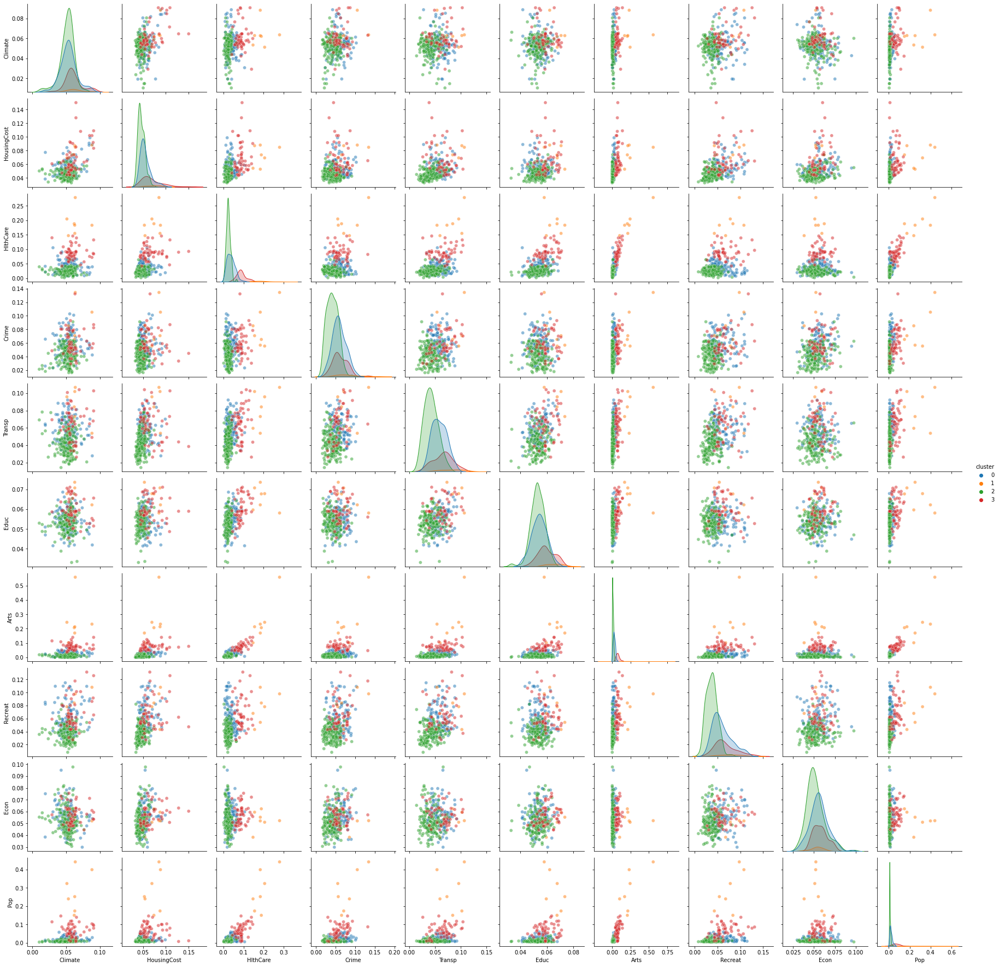

In [427]:
ns_plot = sns.pairplot(data_kmeans.sort_values('cluster'), 
             hue='cluster', 
             plot_kws={'alpha':0.5}, 
            palette = "tab10"
            )
plt.show()

* Определяю наибольшую зависимость признаков между собой.

In [428]:
for col in data_copy.columns:
    print(f'CORR WITW {col}   :\n {data_copy.corr()[col].sort_values()}\n\n**********************\n')

CORR WITW Climate   :
 Econ          -0.100083
Educ           0.064520
Transp         0.079120
Crime          0.192387
HlthCare       0.213303
Recreat        0.213509
Arts           0.226974
Pop            0.244697
HousingCost    0.386291
Climate        1.000000
Name: Climate, dtype: float64

**********************

CORR WITW HousingCost   :
 Crime          0.134222
Educ           0.197934
Econ           0.269433
Transp         0.271922
Pop            0.326294
Climate        0.386291
Recreat        0.422288
Arts           0.448568
HlthCare       0.453010
HousingCost    1.000000
Name: HousingCost, dtype: float64

**********************

CORR WITW HlthCare   :
 Econ           0.069271
Climate        0.213303
Crime          0.304659
Recreat        0.325397
HousingCost    0.453010
Transp         0.470317
Educ           0.490234
Pop            0.827560
Arts           0.865796
HlthCare       1.000000
Name: HlthCare, dtype: float64

**********************

CORR WITW Crime   :
 Educ           

#### Я рассматривала лишь самые интересные, на мой взгляд, зависимости между данными. (Некоторые с наибольшей корреляцией)

## "Климат"

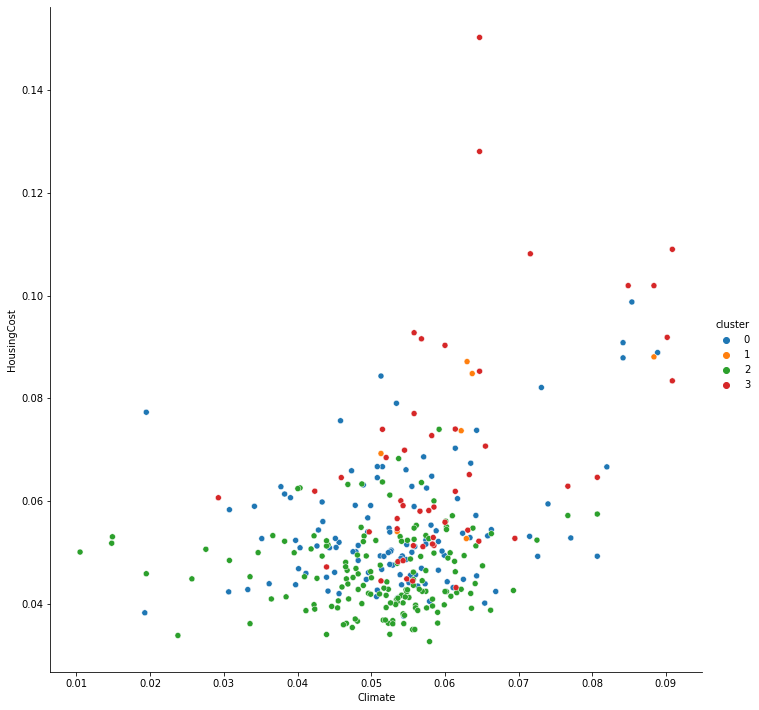

In [187]:
sns.pairplot(x_vars="Climate", 
             y_vars="HousingCost", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* На мой взгляд, **большинство**(зеленый и голубой кластер) городов находятся в **умеренной** климатической зоне, поэтому там оплата жилищных услуг **не слишком высока**.
* Некая часть зеленого кластера находится в **менее комфортных** климатических условиях, но и оплата жилищных условий также невысока.
* Красный кластер и часть голубого, это города, находящиеся в **комфортных/жарких** климатических условиях, там оплата за жилье соответственно возрастает.

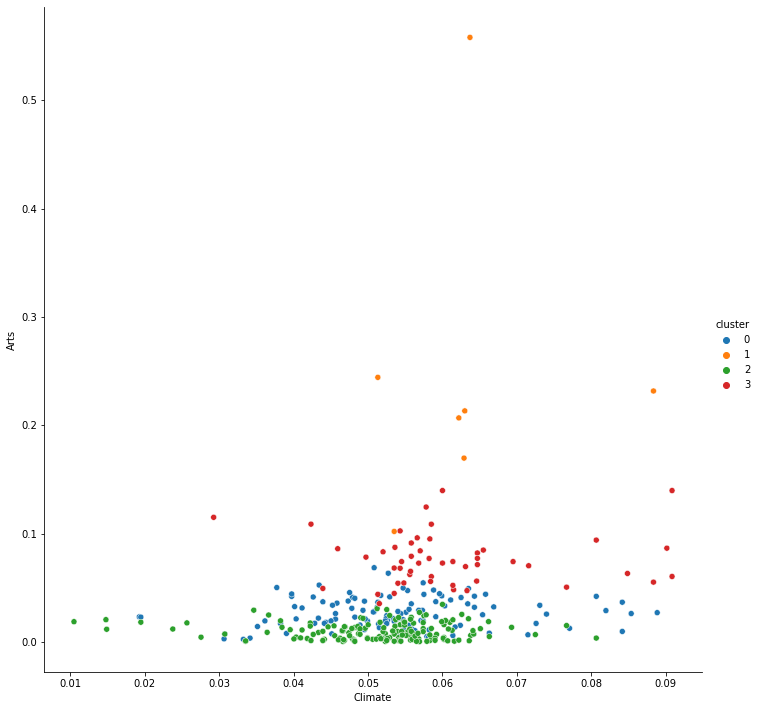

In [188]:
sns.pairplot(x_vars="Climate", 
             y_vars="Arts", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Больше мест, связанных с искусством находится в городах в красном и рыжем кластерах.

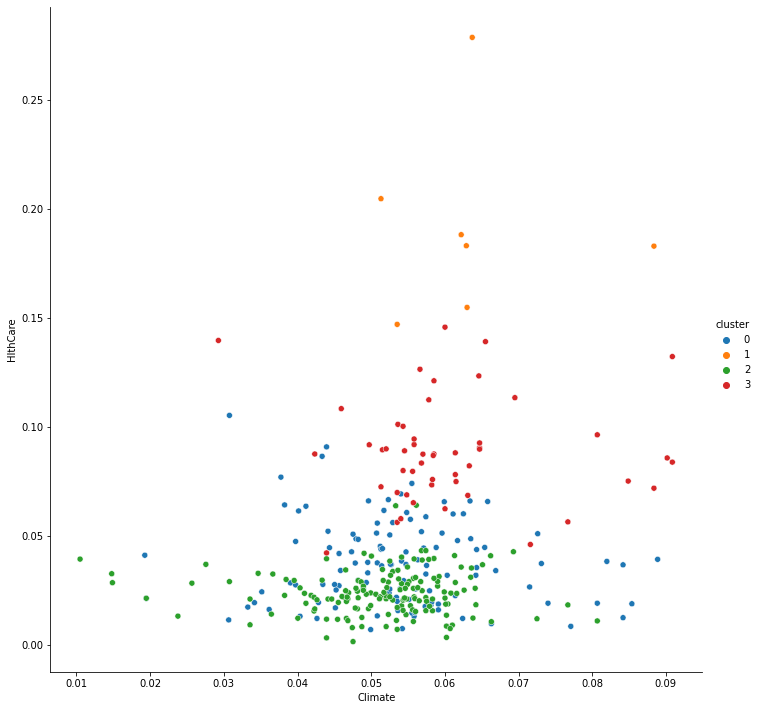

In [189]:
sns.pairplot(x_vars="Climate", 
             y_vars="HlthCare", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* **Большинство** населения, проживающего в **в холодном и умеренном климате** - здравоохранение **не сильно развито**, также и окружающая среда оставляет желать лучшего. (зеленый кластер)
* **Другая часть населения**, проживающая в **умеренном и теплом климате**, их здравоохранение и окружающая среда **немного лучше**. 
* Выделяются две группы населения, у которых здравоохранение и окружающая среда находятся на хорошем уровне(оранжевый и красный кластеры). Самая маленькая группа - те, кто проживают в **самых хороших климатических условиях и окружающей среде (оранжевый кластер)**.

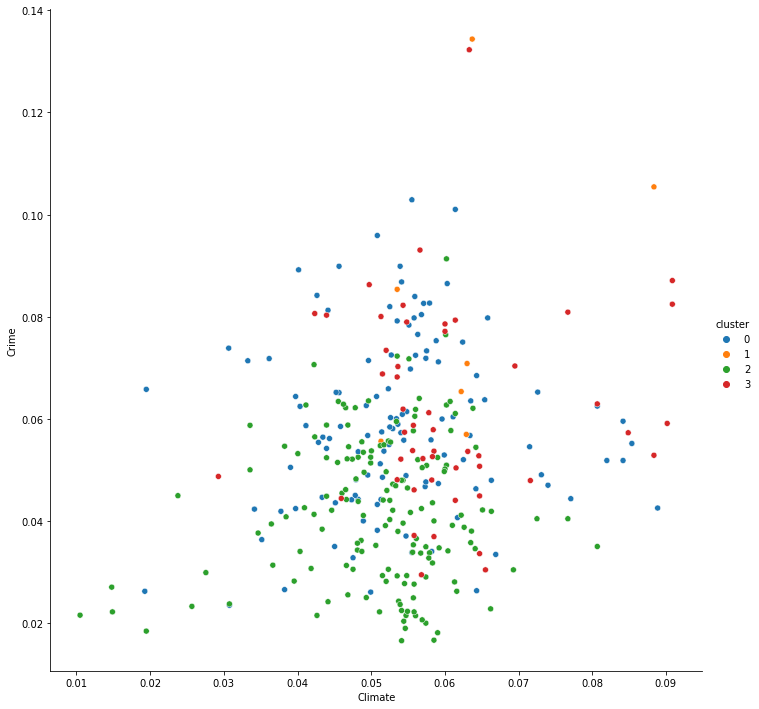

In [190]:
sns.pairplot(x_vars="Climate", 
             y_vars="Crime", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* При просмотре зависимости климата от уровня преступности, **нет четко выделенных групп**, так как все 4 кластера перемешаны между собой.
* Два самых больших кластера, зеленый и голубой , заспределены по шкале преступности, и можно сказать, что **города из голубого кластера**, там немного **больше** уровень преступности, как и в городах из **рыжего кластера**. Однако явной коререляции между признаками нет.

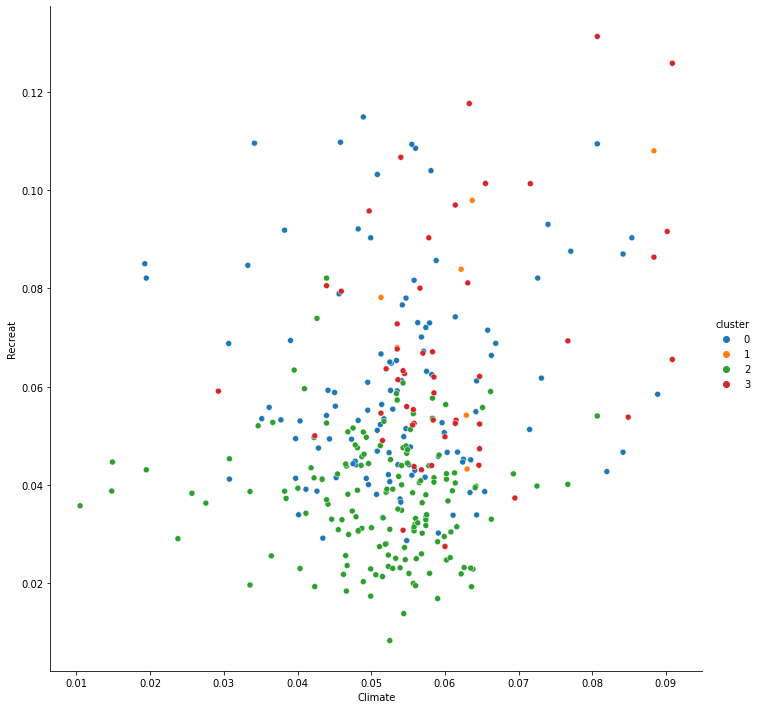

In [191]:
sns.pairplot(x_vars="Climate", 
             y_vars="Recreat", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* **Больше** всего **хороших мест** для отдыха в городах таких кластеров как **голубой, красный и оранжевый**. Они находятся в **жарких и умеренных** климатических условиях. 
* **Меньше хороших мест** для отдыха в **холодной климатической зоне**.

## "Образование" 

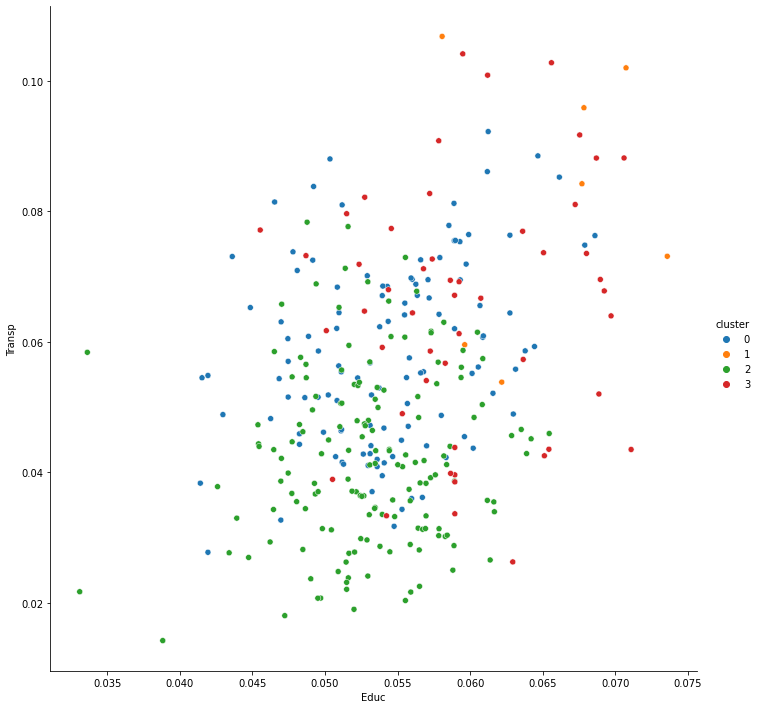

In [192]:
sns.pairplot(x_vars="Educ", 
             y_vars="Transp", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

 * Видно, что все кластеры распределны равномерно с центре, однако для городов оранжевого кластера заметно, что чем выше "уровень" образования, то тем выше  и затраты на транспорт. Вероятнее всего либо учебные учреждения выбираются по их статусу, либо есть больше возможностей у людей использовать транспорт.

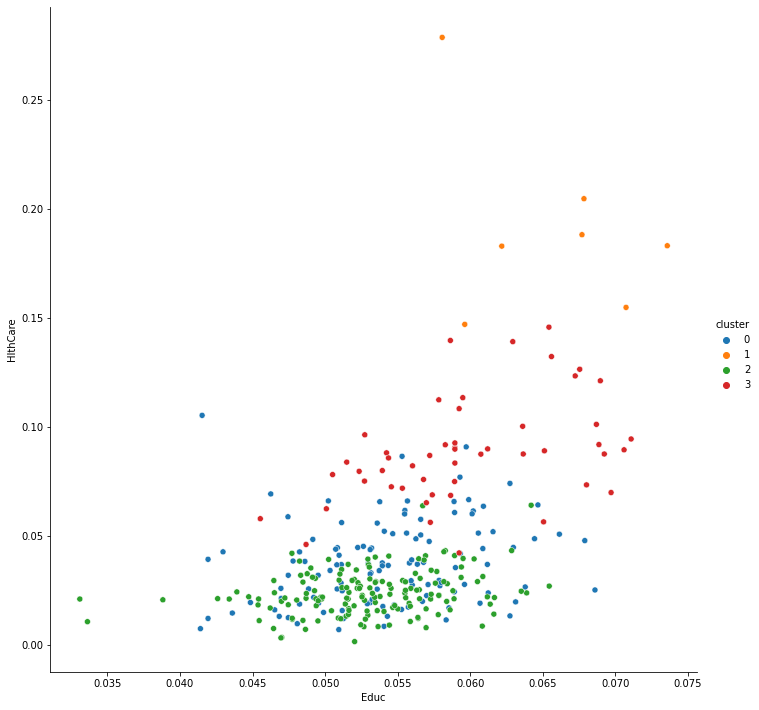

In [317]:
sns.pairplot(x_vars="Educ", 
             y_vars="HlthCare", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Очевидно, что там, где более хорошая экологическая ситуация и лучшее здравоохранение, уровень образования немного выше. (красный и оранжевый кластеры)

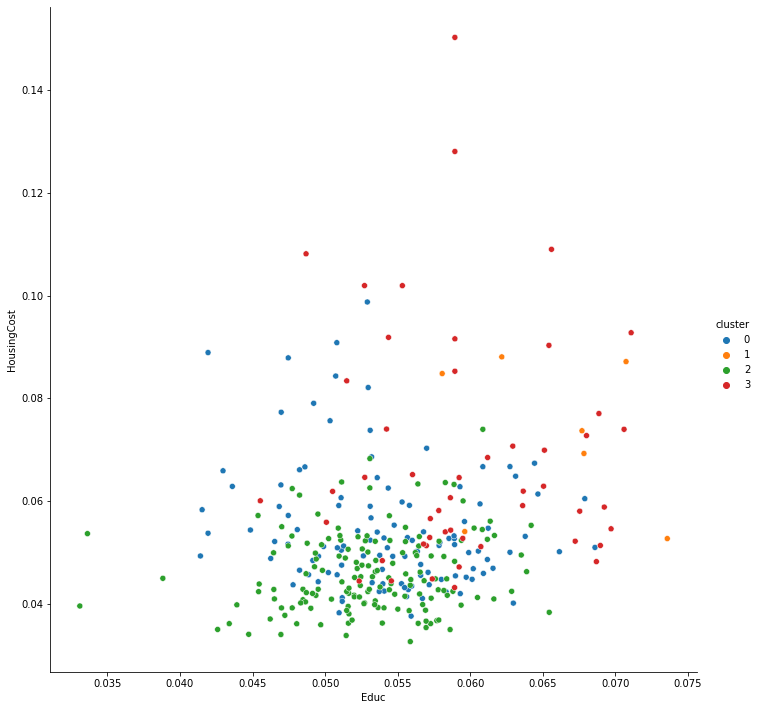

In [321]:
sns.pairplot(x_vars="Educ", 
             y_vars="HousingCost", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Очевидно, что плата за жилье выше там, где ситуация с образованием более благоприятная. (Красный и оранжевый кластеры)

## "Уровень преступности"

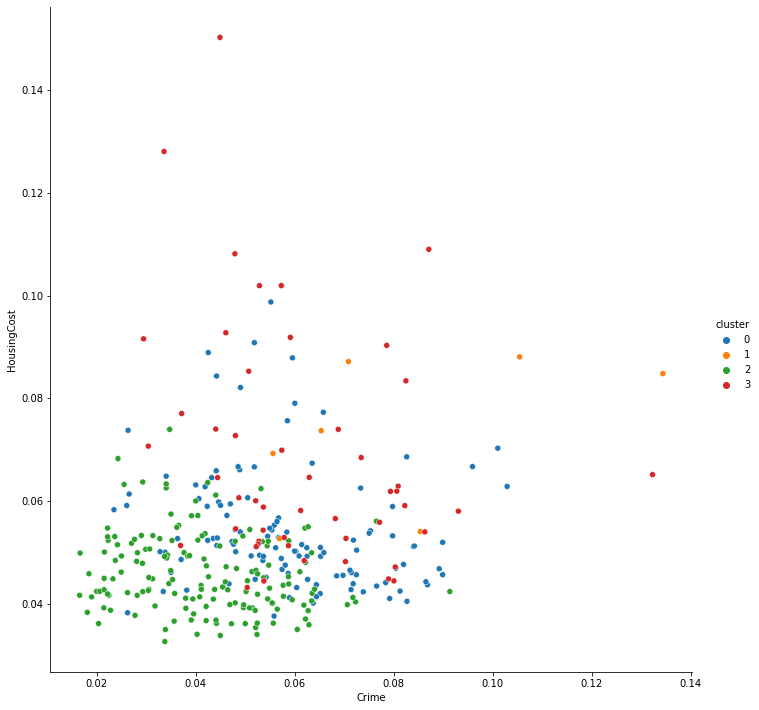

In [193]:
sns.pairplot(x_vars="Crime", 
             y_vars="HousingCost", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* **Самый низкий** уровень преступности в тех городах, где **самые низкие** затраты на жилье и коммунальные нужды.
* Видна тенденция, что **чем выже затраты** на жилье и коммунальные нужды, то **тем выше** и уровень преступности.

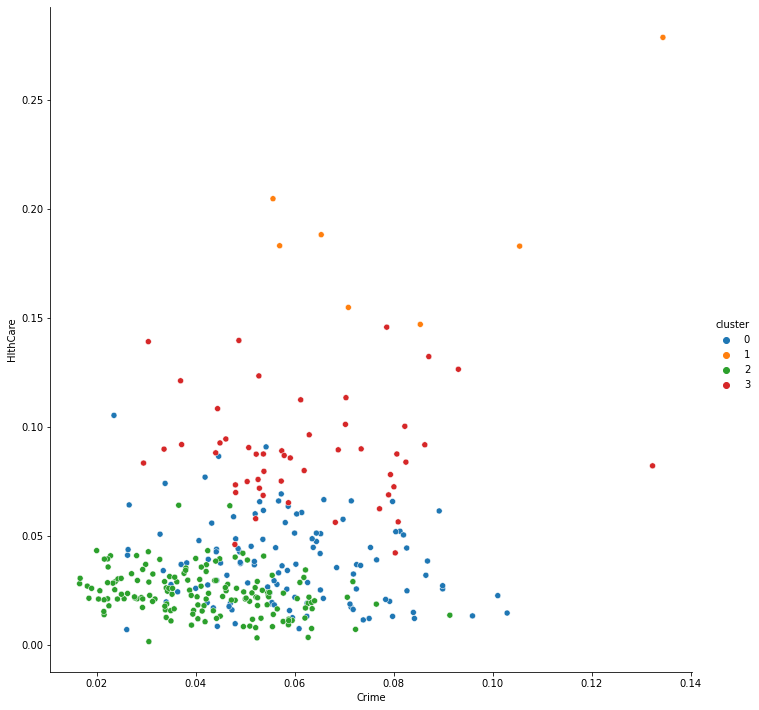

In [194]:
sns.pairplot(x_vars="Crime", 
             y_vars="HlthCare", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

*  Можно сделать вывод, что **уровень преступности не сильно зависит от здравохранения и окружающей среды.**

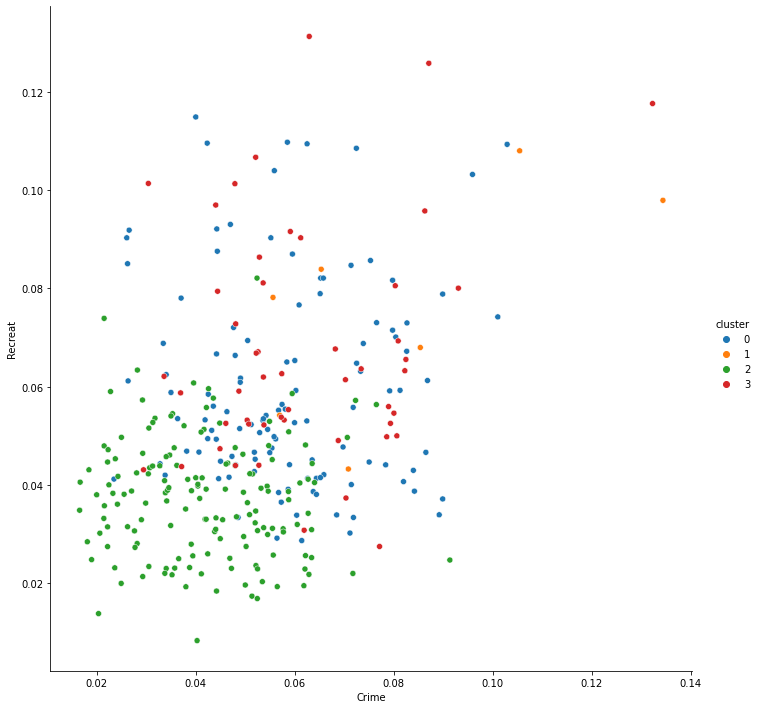

In [318]:
sns.pairplot(x_vars="Crime", 
             y_vars="Recreat", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

 * Малый и средний уровень преступности наблюдается по всей шкале Recreate.
 * В самом большом, зеленом кластере как невысок уровень преступности, так и нет большого кол-ва мест отдыха.

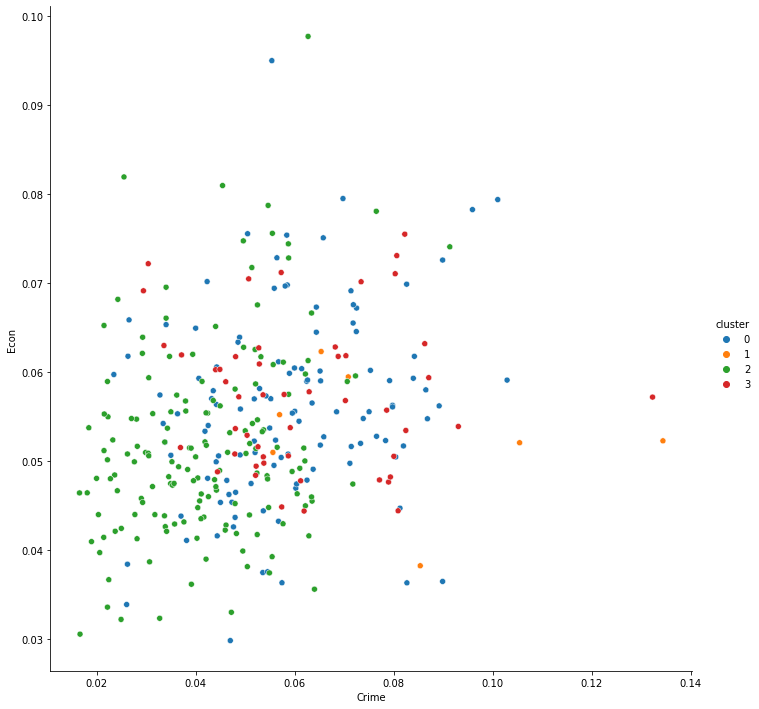

In [319]:
sns.pairplot(x_vars="Crime", 
             y_vars="Econ", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Уровень преступности ниже всего в зеленом кластере , по всей шкале Econ.

## "Экономическая составляющая"

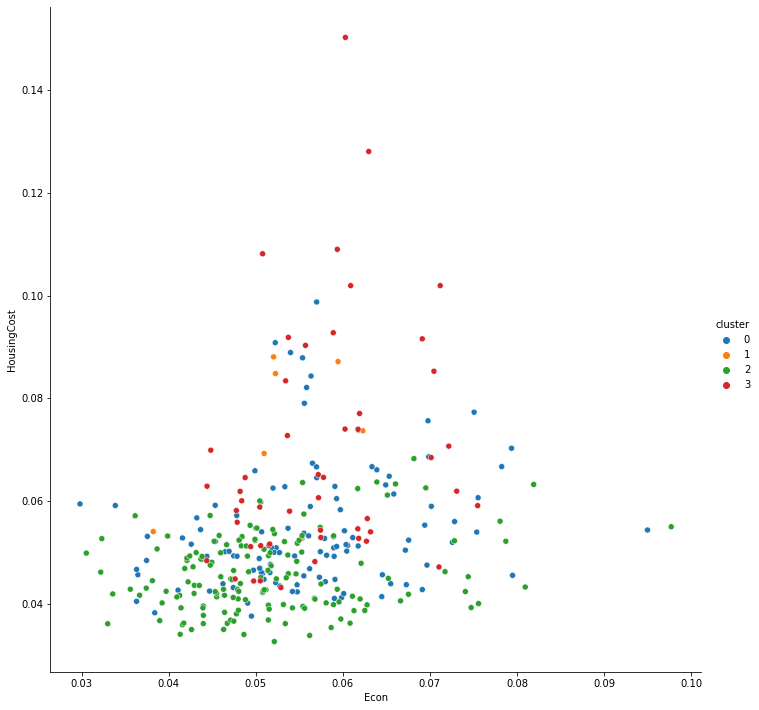

In [195]:
sns.pairplot(x_vars="Econ", 
             y_vars="HousingCost", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* **Большинство городов** по всей стране имеют **небольшой средний доход** и также **небольшую плату за жилищно-коммунальные услуги**.
* Однако в городах со **средним "средним доходом"** из **красного кластера**, стоимость жилищно-коммунальных услуг **сильно завышена**.

## "Коммунальнаые услуги"

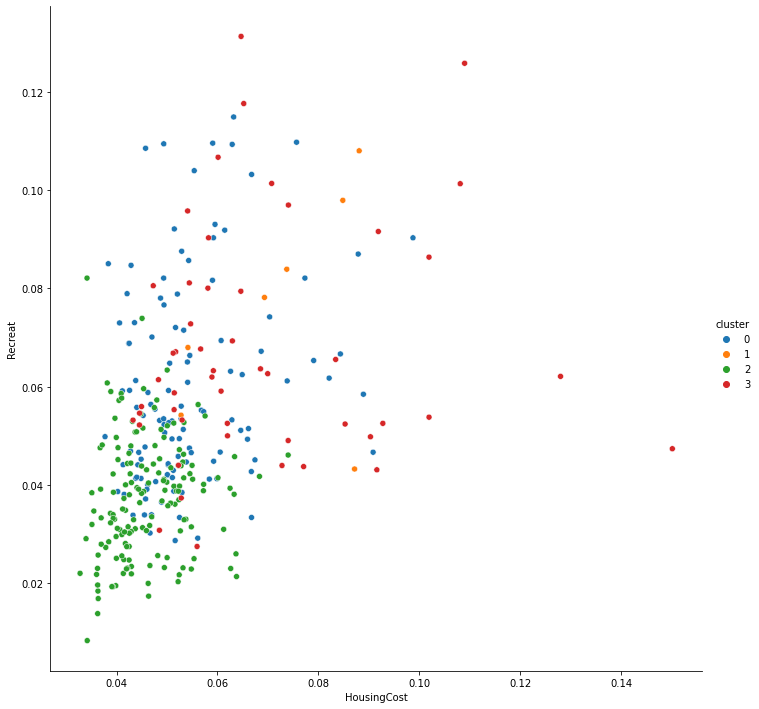

In [198]:
sns.pairplot(x_vars="HousingCost", 
             y_vars="Recreat", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Жилищно-коммунальные платы **выше** в тех городах, где **больше** хороших мест для отдыха.

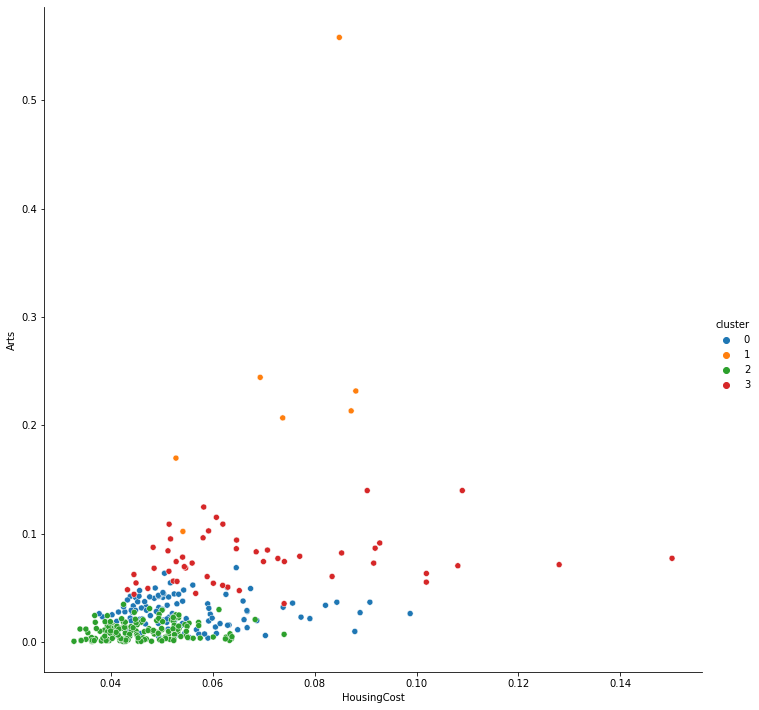

In [199]:
sns.pairplot(x_vars="HousingCost", 
             y_vars="Arts", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Наличие культурных объектов **не имеет особого влияния** на стоимость жилищно-коммунальных услуг.

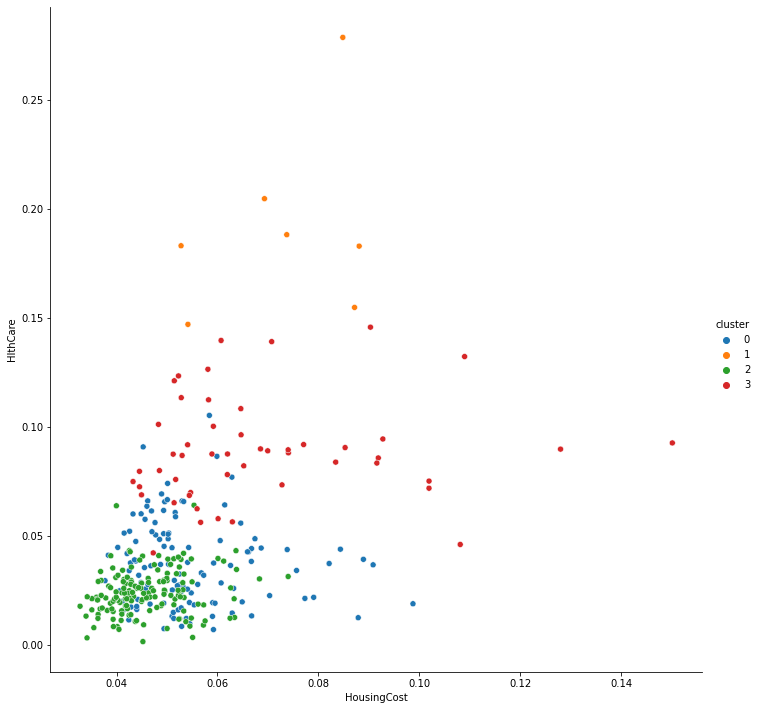

In [322]:
sns.pairplot(x_vars="HousingCost", 
             y_vars="HlthCare", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Очевидно, что цена за жилье поднимается с повышением уровня жизни. Чем лучше здравохранение и/или окружающая среда, тем выше стоимость.  

## "Парки и зоны отдыха"

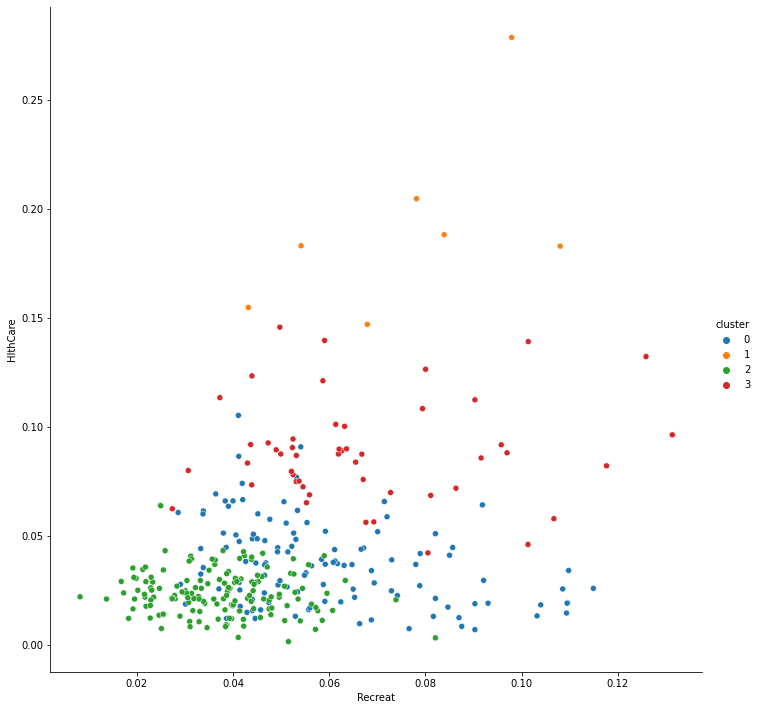

In [201]:
sns.pairplot(x_vars="Recreat", 
             y_vars="HlthCare", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Более благоприятная окружающая среда в тех городах, где больше больше природных запаведников, озер и  тд.

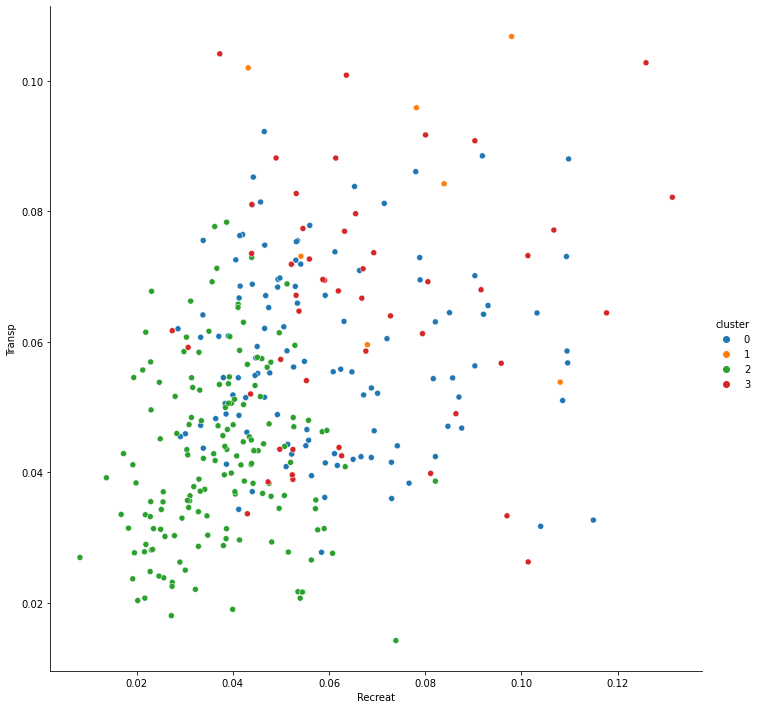

In [324]:
sns.pairplot(x_vars="Recreat", 
             y_vars="Transp", 
             hue='cluster',
             data=data_kmeans.sort_values('cluster'),
             palette = "tab10",
             height=10)
plt.show()

* Транспортная сеть лучше развита в тех городах, где больше мест для отдыха. (Голубой, красный, рыжий кластеры)

### Вывод:
Логичее всего предположить, что:  
* <span style="color:green">Зеленый кластер</span> - города с уровнем жизни, **ниже среднего**.  
* <span style="color:blue">Голубой кластер</span> - города со **средним** уровнем жизни.  
* <span style="color:red">Красный кластер</span> - города с уровнем жизни **выше среднего**.   
* <span style="color:orange">Оранжевый кластер</span> - города с **высоким** уровнем жизни.   

# 8) Распределение кластеров географически. Их оценка.

In [204]:
# Оцените, как полученные кластеры распределены географически.
# Оцените, как полученные кластеры распределены по штатам.
# Можно ли выделить какую-то зависимость (территориальную или для штатов)?
# (Бонусное) Провизуализируйте распределение на карте США.

In [205]:
new = data.loc[:, ['Place', 'Lat', 'Long']]
new['cl_kmeans'] = data_all_cl.loc[:, ['cl_kmeans']]
new

,Place,Lat,Long,cl_kmeans
0,"Abilene,TX",32.5590,-99.6890,2
1,"Akron,OH",41.0850,-81.5180,0
2,"Albany,GA",31.5750,-84.1580,2
3,"Albany-Schenectady-Troy,NY",42.7327,-73.7983,0
4,"Albuquerque,NM",35.0830,-106.6500,0
...,...,...,...,...
324,"Worcester,MA",42.2720,-71.7950,2
325,"Yakima,WA",46.5950,-120.5130,2
326,"York,PA",39.9600,-76.7280,2
327,"Youngstown-Warren,OH",41.1700,-80.7290,2


In [206]:
import plotly.graph_objects as go

mapbox_access_token ="pk.eyJ1IjoiZG9rdGFwb2xhIiwiYSI6ImNrbmJ1NW5nNjExY2kyb21ybmdsN3FieW8ifQ.NB-vO0wD7bCK3W_c3KDHLA"


site_lat = new['Lat']
site_lon = new['Long']
locations_name = new['Place']


fig = go.Figure()

fig.add_trace(go.Scattermapbox(
        lat=site_lat,
        lon=site_lon,
        mode='markers',
        marker=go.scattermapbox.Marker(
            size= 9,
            color=new['cl_kmeans'],
            colorscale='rainbow',
            opacity=0.7
        ),
        text="Place: " + data["Place"].astype(str) + 
             "<br>Population: " + data["Pop"].astype(str) +
             "<br>Climate: " + data["Climate"].astype(str) +
             "<br>HousingCost: " + data["HousingCost"].astype(str) +
             "<br>HlthCare: " + data["HlthCare"].astype(str)+
             "<br>Crime: " + data["Crime"].astype(str)+
             "<br>Transp: " + data["Transp"].astype(str)+
             "<br>Educ: " + data["Educ"].astype(str)+
             "<br>Arts: " + data["Arts"].astype(str)+
             "<br>Recreat: " + data["Recreat"].astype(str)+
             "<br>Econ: " + data["Econ"].astype(str),
    
        hoverinfo='text'
    ))

fig.update_layout(
    title='KMeans Clustering (USA)',
    autosize=False,
    width=1050,
    height=700,
    hovermode='closest',
    showlegend=False,
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=38,
            lon=-94
        ),
        pitch=0,
        zoom=3,
        style='light',
    ),
)


fig.update_layout(mapbox_style="dark", mapbox_accesstoken=mapbox_access_token)

fig.show()

### Оцените, как полученные кластеры распределены географически. 

* Самый большой - <span style="color:green">зеленый кластер</span>, большинство его городов расположены на востоке и юге США.
* Города <span style="color:#e75480;">темнорозового кластера</span> расположены на востоке и юге, а также в штатах тихоокеанского региона.
* Города <span style="color:red">красного кластера</span> имеют большую плотность на востоке сша, рядом с крупнейшими центрами.
* <span style="color:blue">Голубой кластер</span> - самые крупные центры США, расположены на востоке и один на западе.

### Вывод:
* Города из <span style="color:blue">голубого кластера</span> - города-миллионники, все признаки имеют высокие показатели, однако не стоит ориентироваться на значение Climate.  Данные города - крупные экономические центры (NY, LA, ...).
* Города из <span style="color:red">красного кластера</span> - менее крупные города, чем в голубом кластере, уровень жизни немного выше, чем в темнорозовом кластере, крупные промышленные центры, много достопримечательностей.
* Города из <span style="color:#e75480;">темнорозового кластера</span> - уровень жизни немного выше, чем в зеленом кластере. Это небольшие экономические центры.
* Города из <span style="color:green">зеленого кластера</span> - уровень жизни имеет низкие параметры, обычные города, но параметр Education очень высокий. 

* Исходя из значений на экономической карте США и карте достопримечательностей, то кластеризация kmeans показыввает схожие с моими выводами результаты.

## Экономическая карта
<p align="right">
  <img src="http://kontur-map.ru/1513263_BIG_0_0.jpg" width="600">
</p>
<p align="left">
  <img src="http://kontur-map.ru/1513263_BIG_1_0.jpg" width="600">
</p>

## Карта достопримечательностей
<p align="left">
  <img src="https://img.tourister.ru/files/1/1/9/5/0/4/2/8/original.jpg" width="600">
</p>

